# import

In [2]:
from matplotlib import dates as mpl_dates
from matplotlib.pyplot import MultipleLocator
import matplotlib.dates as mdates
from matplotlib.transforms import Transform
from matplotlib.ticker import (AutoLocator, AutoMinorLocator)
from matplotlib.dates import DateFormatter
import matplotlib
from matplotlib import pyplot
import matplotlib.pylab as plt
from matplotlib import cm
from matplotlib import rcParams
from matplotlib.patches import Circle, Rectangle, Ellipse, Polygon, FancyArrow
from matplotlib.collections import PatchCollection, LineCollection


import datetime
from collections import OrderedDict

In [3]:
from __future__ import absolute_import, print_function, division

from astropy.io.fits import getheader
from astropy.io.fits import getdata




from astropy.utils.data import get_pkg_data_filename
import aplpy

from astropy import log
from astropy.io import fits
import astropy.coordinates as coord
from astropy import units as u
from astropy.coordinates import SkyCoord
from astropy.time import Time
from astropy.table import Table
from astropy.wcs import WCS
from astropy import constants as const
from astropy.constants import k_B



import time
import math
import os,sys
import numpy as np
import pandas as pd

%matplotlib inline
%config InlineBackend.figure_format = "svg"
from matplotlib import rcParams
#rcParams["savefig.dpi"] = 300 #%matplotlib inline

# def

## get_obsids

In [4]:
import os,sys,re
import time
#from datetime import datetime
import numpy as np
from astropy.io import fits

def get_obsids(path):
    dirname=os.listdir(path)
    obsids=[]
    for i in dirname:
        if i.isdigit():
            obsids.append(i)
    obsids.sort()        
    return obsids

def get_flag_tiles(metafits_file):
    flag_tiles=[]
    metafits=fits.open(metafits_file)
    for i,j in zip(metafits[1].data['Antenna'],metafits[1].data['Flag']):
        if j==1:
        #print(i,j)
            if i not in flag_tiles:
                flag_tiles.append(i)
    return flag_tiles

## def_ax

In [5]:
import matplotlib as mpl
def set_ax_tick(ax):
    ax.xaxis.set_tick_params(which='major', size=10, width=2, direction='in', top='on',)
    ax.xaxis.set_tick_params(which='minor', size=5, width=2, direction='in', top='on')
    ax.yaxis.set_tick_params(which='major', size=10, width=2, direction='in', right='on')
    ax.yaxis.set_tick_params(which='minor', size=5, width=2, direction='in', right='on')

def set_ax_locator(ax,xma=1,xmi=0.2,yma=1,ymi=0.2):
    ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(xma))
    ax.xaxis.set_minor_locator(mpl.ticker.MultipleLocator(xmi))
    ax.yaxis.set_major_locator(mpl.ticker.MultipleLocator(yma))
    ax.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(ymi)) 

## time_convert

In [6]:
def datetime2mjd(x):
    mjd_ref=59000
    mjd_minus_mdates_num=mdates.date2num(convert_xaxis_time(mjd_ref))-mjd_ref
    
    x=mdates.date2num(x)
    y = x - mjd_minus_mdates_num   
    return y

def mjd2datetime(x):
    mjd_ref=59000
    mjd_minus_mdates_num=mdates.date2num(convert_xaxis_time(mjd_ref))-mjd_ref
    y= x + mjd_minus_mdates_num
    y= mdates.num2date(y)
    return y


def datenums2mjd(x):
    #x=mdates.date2num(x)
    mjd_ref=59000
    mjd_minus_mdates_num=mdates.date2num(convert_xaxis_time(mjd_ref))-mjd_ref
    y = x - mjd_minus_mdates_num   
    return y

def mjd2numsdate(x):
    mjd_ref=59000
    mjd_minus_mdates_num=mdates.date2num(convert_xaxis_time(mjd_ref))-mjd_ref
    
    y= x + mjd_minus_mdates_num
    #y= mdates.num2date(y)
    return y


def datetime2mjd(x):
    mjd_ref=59000
    mjd_minus_mdates_num=mdates.date2num(convert_xaxis_time(mjd_ref))-mjd_ref
    
    x=mdates.date2num(x)
    y = x - mjd_minus_mdates_num   
    return y

def mjd2datetime(x):
    mjd_ref=59000
    mjd_minus_mdates_num=mdates.date2num(convert_xaxis_time(mjd_ref))-mjd_ref
    y= x + mjd_minus_mdates_num
    y= mdates.num2date(y)
    return y

def newdatetime2mjd(x):     
    return Time(x).mjd 

def mjd2datetimenew(x):
    return Time(x,format='mjd').to_datetime()

In [7]:
def convert_xaxis_mjd(time):
    return Time(time).mjd   

def convert_xaxis_time(mjd):
    return Time(mjd,format='mjd').to_datetime()


def date2yday(x):
    """
    x is in matplotlib datenums, so they are floats.
    """
    y = x - mdates.date2num(datetime(2018, 1, 1))
    return y

def yday2date(x):
    """
    return a matplotlib datenum (x is days since start of year of 2018)
    """
    y = x + mdates.date2num(datetime(2018, 1, 1))
    return y


def convert_partial_year(numbers):
    datetimes=[]
    for number in numbers:
        year = int(number)
        d = timedelta(days=(number - year)*(365 + is_leap(year)))
        day_one = datetime(year,1,1)
        date = d + day_one
        datetimes.append(date)
    return datetimes


def is_leap(year):
    if not year%4 and  year%100 or not year%400:
        return True
    return False


def convert_mjd(times):
    timesmjd=[]
    for i in times:
        timesmjd.append(Time(i).mjd)
    return timesmjd  


def convert_date(times):
    timesdate=[]
    for i in times:
        timesdate.append(Time(i,format='mjd').datetime)
    return timesdate

def convert_date_single(time):
    timedate=Time(time,format='mjd').datetime
    return timedate

## gpstime

In [ ]:
obsid=1198598960
mjd=Time(obsid, format='gps').mjd
print(mjd,convert_xaxis_time(mjd))

In [ ]:
obsid=1207652304
mjd=Time(obsid, format='gps').mjd
print(mjd,convert_xaxis_time(mjd))

# PATH_data

In [187]:
ipynb_path='/share/home/blv/mwa_code_py/ipynb'

path_img='/share/home/blv/MWAdata/qguo_data/img'
casaimg='/share/home/blv/MWAdata/qguo_data/casa_img/'

path_lc='/share/home/blv/MWAdata/qguo_data/lightcurve/'
path_lc_ratio='/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio'
path_calibrate_lightcurve='/share/home/blv/MWAdata/qguo_data/lightcurve/calibrate_lightcurve'

path_aocal='/share/home/blv/MWAdata/qguo_data/aocal_plot_bin/'

path_spec='/share/home/blv/MWAdata/qguo_data/spec/'
path_skymodel='/share/home/blv/MWAdata/qguo_data/skymodels'
path_zip='/share/home/blv/MWAdata/qguo_data/zip/'

path_157='/share/home/blv/MWAdata/qguo_data/zip/157/'
obsids_157=get_obsids(path_157)
#obsid=obsids_157[0]

In [9]:
len(obsids_157)

6

## nan_157_path

In [10]:
nan_path_157='/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/'
obsids_nan_path_157=get_obsids(nan_path_157)

In [11]:
len(obsids_nan_path_157)

8

## src1000_large3


In [288]:
path_src1000_large3='/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large3/'

## src1000_large6_path

In [348]:
path_src1000_large6='/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large6/'

In [ ]:
size 4096
scale 0.003

# check_download_done_tmp

In [ ]:
tmp_obsids=[]
for i in range(1,93):
    tmp=False
    obsid_i=obsids_157[i]
    files=os.listdir(os.path.join(path_157,obsid_i))
    for file in files:
        if file.endswith('.tmp'):
            tmp=True
    if tmp==True :
        #print(i,obsid_i)  
        tmp_obsids.append(obsid_i)

len_list=len(obsids_157)
print('len_list:',len_list)
#len_list=50
bat_num_once=6

for index,i in enumerate(np.arange(0,len_list,bat_num_once)):
    range_start=str(i)
    if index>len_list/bat_num_once-1:
        range_end='%d'%len_list
    else:
        range_end=str(i+bat_num_once)       
    #os.system('cp PKS0736_step_all_toend.py PKS0736_step_all_toend_p%d.py'%index)
    #print('PKS0736_step_all_toend_p%d.py'%index)
    for j in range(int(range_start),int(range_end)):
        #print(index,j,obsnums[j])
        if obsids_157[j] in tmp_obsids:
            print('tmp',index,obsids_157[j])
            
            #if index <12 and index>4:
            print('rm /share/home/blv/MWAdata/qguo_data/zip/157/%s/*tmp*'%obsids_157[j])
            #os.system('rm /share/home/blv/MWAdata/qguo_data/zip/157/%s/*tmp*'%obsids_157[j])
                
            #if index < 10:
                #print(os.listdir(os.path.join(datadir,obsnums[j])))

In [ ]:
import math

def get_nan_obsid(path,prefix='first'):
    nan_obsids=[]

    not_done_obsids=[]    
    obsnums=get_obsids(path)
    done_obsids=[]
    for obsnum in obsnums:
        stokes_file_I=os.path.join(path,obsnum,'stokes-%s-%s-I.fits'%(obsnum,prefix))
        if not os.path.exists(stokes_file_I):
            not_done_obsids.append(obsnum)
        else:   
            done_obsids.append(obsnum)
            hdl_stokes_I=fits.open(stokes_file_I)         
            if math.isnan(hdl_stokes_I[0].data[0][0][0][0]):
                nan_obsids.append(obsnum)              
    return nan_obsids,not_done_obsids,done_obsids

nan_obsids,not_done_obsids,done_obsids=get_nan_obsid(path_157,prefix='briggsplus1')
len_list=len(obsids_157)
print('len_list:',len_list)
#len_list=50
bat_num_once=6

for index,i in enumerate(np.arange(0,len_list,bat_num_once)):
    range_start=str(i)
    if index>len_list/bat_num_once-1:
        range_end='%d'%len_list
    else:
        range_end=str(i+bat_num_once)       
    #os.system('cp PKS0736_step_all_toend.py PKS0736_step_all_toend_p%d.py'%index)
    #print('PKS0736_step_all_toend_p%d.py'%index)
    for j in range(int(range_start),int(range_end)):
        #print(index,j,obsnums[j])
        if obsids_157[j] in not_done_obsids:
            print('notdone',index,obsids_157[j])
        elif obsids_157[j] in nan_obsids:
            print('nan_obsids',index,obsids_157[j])     
                    

In [ ]:
for i in nan_obsids:
    os.system('cp %s/%s_ms.zip %s/nan_157/'%(path_157,i,path_157))

In [ ]:
for i in nan_obsids:
    os.system('cp -r %s/%s/ %s/nan_157/'%(path_157,i,path_157))

In [ ]:
for i in nan_obsids:
    command='rm -r %s%s/* '%(path_157,i)
    #print(command)
    #os.system(command)

# solution

WGET http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=OBSID&zipfile=
1&add_request=1

where OBSID should be replaced with the observation ID of the target
or explicit calibrator observation.

wget http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=1207652304&zipfile=1&add_request=1

 wget http://ws.mwatelescope.org/calib/get_calfile_for_calid?cal_id=1207652304

In [ ]:
wget -c -O 1207652304_sol.zip http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=1207652304&zipfile=1&add_request=1

In [ ]:
wget -c -O 1207652904_sol.zip http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=1207652904&zipfile=1&add_request=1

## download

for i in range(0,5):
    obsid=obsids_157[i]

    os.chdir(os.path.join(path_157,obsid))
    print(os.getcwd())
    if not os.path.exists('%s_sol.zip'%obsid):
        download_cmd='wget -c -O %s_sol.zip http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=%s&zipfile=1&add_request=1'%(obsid,obsid)
        print(download_cmd)
        #os.system(download_cmd)
        
    else:
        print(obsid,'done')
os.chdir(ipynb_path)        

## unzip

for i in range(0,5):
    obsid=obsids_157[i]

    os.chdir(os.path.join(path_157,obsid))
    print(os.getcwd())
    if not os.path.exists('%s_sol'%obsid):
        if os.path.exists('%s_sol.zip'%obsid):
            zip_cmd='unzip %s_sol.zip -d %s_sol'%(obsid,obsid)
            print(zip_cmd)
            os.system(zip_cmd)      
    else:
        print(obsid,'unzip done')
os.chdir(ipynb_path)         

## cp bin

for i in range(0,5):
    obsid=obsids_157[i]
    os.chdir(os.path.join(path_157,obsid))
    print(os.getcwd())
    if os.path.exists('%s_sol'%obsid):
        files=os.listdir('%s_sol'%obsid)
        for f in files:
            if f.endswith('.bin'):
                print(f)
                if not os.path.exists(os.path.join(path_157,obsid,f)):
                    print(f,'cp notdone')
                    cp_cmd='cp %s_sol/%s .'%(obsid,f)
                    print(cp_cmd)
                    #os.system(cp_cmd) 
                    
                    
                else:
                    print(f,'cp done')
                    #cp_cmd='cp %s_sol/%s .'%(obsid,f)
                    #print(cp_cmd)
    print()            
    
os.chdir(ipynb_path)     

## ls bin

In [ ]:
for i in range(0,5):
    obsid=obsids_157[i]
    os.chdir(os.path.join(path_157,obsid))
    print(os.getcwd())
    if os.path.exists('%s_sol'%obsid):
        files=os.listdir()
        for i in files:
            if i.endswith('.bin'):
                print(i)
    print()  
os.chdir(ipynb_path)     

In [ ]:
for i in range(0,5):
    obsid=obsids_157[i]
    os.chdir(os.path.join(path_157,obsid))
    print(os.getcwd())
    if os.path.exists('%s_sol'%obsid):
        files=os.listdir('%s_sol'%obsid)
        for i in files:
            print(i)
os.chdir(ipynb_path)             

In [ ]:
pwd

os.chdir(nan_path_157)
for i in obsids_nan_path_157:
    if not os.path.exists('%s_sol.zip'%i):
        wget_cmd='wget -c -O %s_sol.zip http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=%s&zipfile=1&add_request=1'%(i,i)
        print(wget_cmd)
        os.system(wget_cmd)
        
os.chdir(ipynb_path)         

In [ ]:
wget -c -O 1207742064_sol.zip http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=1207742064&zipfile=1&add_request=1

In [ ]:
wget -c -O 1208086720_sol.zip http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=1208086720&zipfile=1&add_request=1

In [ ]:
wget -c -O 1208345216_sol.zip http://mro.mwa128t.org/calib/get_calfile_for_obsid?obs_id=1208345216&zipfile=1&add_request=1

# skymodel

## create_skymodel

python3 create_skymodel GLEAM_EGC_v2.fits 1207652304.metafits -o skymodel_1Jy_212MHz.txt -R 20 -p -n 100 -z 212 -r int_flux_212 --ra_key 'RAJ2000' --dec_key 'DEJ2000' -t 1 --index 'alpha' --alpha 0.0

In [ ]:
python3 create_skymodel GLEAM_EGC_v2.fits 1207652304.metafits -o skymodel_4Jy_212MHz.txt -R 120 -p -n 1000 -z 212 -r int_flux_212 --ra_key 'RAJ2000' --dec_key 'DEJ2000' -t 4 --index 'alpha' --alpha 0.0

In [ ]:
python3 create_skymodel GLEAM_EGC_v2.fits 1207652304.metafits -o skymodel_2Jy_212MHz.txt -R 120 -p -n 1000 -z 212 -r int_flux_212 --ra_key 'RAJ2000' --dec_key 'DEJ2000' -t 2 --index 'alpha' --alpha 0.0

In [ ]:
python3 create_skymodel GLEAM_EGC_v2.fits 1207652304.metafits -o skymodel_4Jy_212MHz_200deg.txt -R 200 -p -n 1000 -z 212 -r int_flux_212 --ra_key 'RAJ2000' --dec_key 'DEJ2000' -t 4 --index 'alpha' --alpha 0.0

In [ ]:
python3 create_skymodel GLEAM_EGC_v2.fits 1207652304.metafits -o skymodel_1Jy_212MHz.txt -R 120 -p -n 1000 -z 212 -r int_flux_212 --ra_key 'RAJ2000' --dec_key 'DEJ2000' -t 1 --index 'alpha' --alpha 0.0

## srclist skymodel

In [ ]:
## gen_model
obsid=1207652304
npoint_cal=100
msfile=obsid
print('python2 srclist_by_beam.py -x --aocalibrate -m %s.metafits -n %d -s srclist_pumav3_EoR0aegean_EoR1pietro+ForA.txt'%(msfile,npoint_cal))    
print()
## model2fits

obsid=1207652304
npoint_cal=100
print('python model2fits.py srclist_pumav3_EoR0aegean_EoR1pietro+ForA_%s_aocal%s.txt'%(obsid,npoint_cal))
print()
## vo2model

obsid=1207652304
npoint_cal=100
print('python2 vo2model_py2.py --catalogue srclist_pumav3_EoR0aegean_EoR1pietro+ForA_%s_aocal%s.fits --output srclist_pumav3_EoR0aegean_EoR1pietro+ForA_%s_aocal%s.txt'%(obsid,npoint_cal,obsid,npoint_cal))
print()

## 100_4Jy

In [13]:
npoint_cal=100
skymodel_fitsfile_100='/share/home/blv/MWAdata/qguo_data/skymodels/1207652304_srclist_cal_100.fits'
skymodelhdul_100 = fits.open(skymodel_fitsfile_100)
skymodelhdul_100.info()
skymodeldata_100=skymodelhdul_100[1].data

skymodeldata_100_4Jy=skymodeldata_100[skymodeldata_100['peak_flux']>4]
print(len(skymodeldata_100_4Jy))

ra_100_4Jy=skymodeldata_100[skymodeldata_100['peak_flux']>4]['ra']
dec_100_4Jy=skymodeldata_100[skymodeldata_100['peak_flux']>4]['dec']

print('ra_100_4Jy',len(ra_100_4Jy))

Filename: /share/home/blv/MWAdata/qguo_data/skymodels/1207652304_srclist_cal_100.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1                1 BinTableHDU     30   100R x 11C   [14A, D, D, 10A, 9A, D, D, D, D, D, D]   
54
ra_100_4Jy 54


In [14]:
skymodeldata_100_10Jy=skymodeldata_100[skymodeldata_100['peak_flux']>10]
print(len(skymodeldata_100_10Jy))

19


## 1000_4Jy

In [15]:
npoint_cal=1000
obsid=1207652304

skymodel_fitsfile_1000='/share/home/blv/MWAdata/qguo_data/skymodels/srclist_pumav3_EoR0aegean_EoR1pietro+ForA_%s_aocal%s.fits'%(obsid,npoint_cal)
skymodelhdul_1000 = fits.open(skymodel_fitsfile_1000)
skymodelhdul_1000.info()
skymodeldata_1000=skymodelhdul_1000[1].data

skymodeldata_1000_4Jy=skymodeldata_1000[skymodeldata_1000['peak_flux']>4]
ra_1000_4Jy=skymodeldata_1000[skymodeldata_1000['peak_flux']>4]['ra']
dec_1000_4Jy=skymodeldata_1000[skymodeldata_1000['peak_flux']>4]['dec']
print('skymodeldata_1000_4Jy',len(skymodeldata_1000_4Jy))

Filename: /share/home/blv/MWAdata/qguo_data/skymodels/srclist_pumav3_EoR0aegean_EoR1pietro+ForA_1207652304_aocal1000.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1                1 BinTableHDU     30   1000R x 11C   [14A, D, D, 10A, 9A, D, D, D, D, D, D]   
skymodeldata_1000_4Jy 96


In [16]:
skymodeldata_1000_10Jy=skymodeldata_1000[skymodeldata_1000['peak_flux']>10]
print(len(skymodeldata_1000_10Jy))

27


In [18]:
skymodeldata_1000_1Jy=skymodeldata_1000[skymodeldata_1000['peak_flux']>1]
print('skymodeldata_1000_1Jy',len(skymodeldata_1000_1Jy))

skymodeldata_1000_1Jy 500


### 1000_imagecenter_3Jy

In [19]:
skymodeldata_1000_center=skymodeldata_1000[skymodeldata_1000['ra']<125]
skymodeldata_1000_center=skymodeldata_1000_center[skymodeldata_1000_center['ra']>113]
skymodeldata_1000_center=skymodeldata_1000_center[skymodeldata_1000_center['dec']>0]
skymodeldata_1000_center=skymodeldata_1000_center[skymodeldata_1000_center['dec']<12]

skymodeldata_1000_center_4Jy=skymodeldata_1000_center[skymodeldata_1000_center['peak_flux']>4]
print('skymodeldata_1000_center_4Jy',len(skymodeldata_1000_center_4Jy))

skymodeldata_1000_center_3Jy=skymodeldata_1000_center[skymodeldata_1000_center['peak_flux']>3]
print('skymodeldata_1000_center_3Jy',len(skymodeldata_1000_center_3Jy))

skymodeldata_1000_center_4Jy 15
skymodeldata_1000_center_3Jy 26


In [20]:
skymodeldata_1000_midcenter=skymodeldata_1000[skymodeldata_1000['ra']<121]
skymodeldata_1000_midcenter=skymodeldata_1000_midcenter[skymodeldata_1000_midcenter['ra']>117]
skymodeldata_1000_midcenter=skymodeldata_1000_midcenter[skymodeldata_1000_midcenter['dec']>4]
skymodeldata_1000_midcenter=skymodeldata_1000_midcenter[skymodeldata_1000_midcenter['dec']<8]
skymodeldata_1000_midcenter_1Jy=skymodeldata_1000_midcenter[skymodeldata_1000_midcenter['peak_flux']>1]
print('skymodeldata_1000_midcenter_1Jy',len(skymodeldata_1000_midcenter_1Jy))

skymodeldata_1000_midcenter_1Jy 19


### 1000_infield

In [21]:
skymodeldata_1000_infield=skymodeldata_1000[skymodeldata_1000['ra']<117]
skymodeldata_1000_infield=skymodeldata_1000_infield[skymodeldata_1000_infield['ra']>113]
skymodeldata_1000_infield=skymodeldata_1000_infield[skymodeldata_1000_infield['dec']>0]
skymodeldata_1000_infield=skymodeldata_1000_infield[skymodeldata_1000_infield['dec']<4]

print('skymodeldata_1000_infield',len(skymodeldata_1000_infield))

skymodeldata_1000_infield_1Jy=skymodeldata_1000_infield[skymodeldata_1000_infield['peak_flux']>1]
print('skymodeldata_1000_infield_1Jy',len(skymodeldata_1000_infield_1Jy))

skymodeldata_1000_infield 63
skymodeldata_1000_infield_1Jy 12


In [22]:
skymodeldata_1000_infield_1Jy['ra'],skymodeldata_1000_infield_1Jy['dec']

(array([116.26833333, 113.47833333, 114.825     , 113.64166667,
        115.20541667, 115.68333333, 116.02541667, 115.50041667,
        114.61208333, 116.24458333, 114.48791667, 113.47541667]),
 array([2.00277778, 2.03944444, 1.61805556, 3.25388889, 1.71444444,
        1.09861111, 3.03083333, 0.86805556, 2.07527778, 3.38      ,
        1.61888889, 3.99305556]))

In [23]:
skymodeldata_1000_infield_1Jy['Name']

chararray(['J074504+020010', 'J073354+020223', 'J073918+013708',
           'J073433+031515', 'J074049+014257', 'J074244+010602',
           'J074406+030157', 'J074200+005211', 'J073826+020438',
           'J074458+032253', 'J073757+013705', 'J073353+035936'],
          dtype='<U14')


## calibration_1000_data_220MHz 

In [24]:
calibration_1000_source_model_name = '/share/home/blv/MWAdata/qguo_data/skymodels/srclist_pumav3_EoR0aegean_EoR1pietro+ForA_1207652304_aocal1000.txt'
calibration_1000_outfile= calibration_1000_source_model_name[:-4]+'my.fits'
calibration_1000_hdul=fits.open(calibration_1000_outfile)
calibration_1000_data=calibration_1000_hdul[1].data

In [25]:
calibration_1000_data[calibration_1000_data['Name']=='J074504+020010']

FITS_rec([('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0.,  80., 24.63),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 100., 19.19),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 120., 15.75),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 140., 13.38),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 160., 11.66),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 180., 10.35),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 200.,  9.32),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 220.,  8.49),
          ('J074504+020010', 116.26833333, 2.00277778, '07:45:04.4', '+02:00:10', 0., 0., 0., 240.,  7.8 )],
         dtype=(numpy.recor

In [26]:
calibration_1000_data_220=calibration_1000_data[calibration_1000_data['freq']==220]

In [27]:
len(calibration_1000_data_220)

1000

In [28]:
calibration_1000_data_220.columns

ColDefs(
    name = 'Name'; format = '14A'
    name = 'ra'; format = 'D'
    name = 'dec'; format = 'D'
    name = 'ra_str'; format = '10A'
    name = 'dec_str'; format = '9A'
    name = 'a'; format = 'D'
    name = 'b'; format = 'D'
    name = 'pa'; format = 'D'
    name = 'freq'; format = 'D'
    name = 'flux'; format = 'D'
)

# GLEAM

In [29]:
GLEAM_path='/share/home/blv/mwa_code_py/for_hp/skymodel/scripts/GLEAM_EGC_v2.fits'
gleam=fits.open(GLEAM_path)
gleamdata=gleam[1].data

## gleamdata.columns

In [30]:
gleamdata.columns

ColDefs(
    name = 'Name'; format = '20A'
    name = 'background_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'local_rms_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'ra_str'; format = '11A'; unit = 'h:m:s'
    name = 'dec_str'; format = '12A'; unit = 'd:m:s'
    name = 'RAJ2000'; format = 'E'; unit = 'deg'
    name = 'err_RAJ2000'; format = 'D'; unit = 'deg'
    name = 'DEJ2000'; format = 'E'; unit = 'deg'
    name = 'err_DEJ2000'; format = 'D'; unit = 'deg'
    name = 'peak_flux_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'err_peak_flux_wide'; format = 'E'; unit = 'Jy/beam'
    name = 'int_flux_wide'; format = 'E'; unit = 'Jy'
    name = 'err_int_flux_wide'; format = 'E'; unit = 'Jy'
    name = 'a_wide'; format = 'E'; unit = 'arcsec'
    name = 'err_a_wide'; format = 'E'; unit = 'arcsec'
    name = 'b_wide'; format = 'E'; unit = 'arcsec'
    name = 'err_b_wide'; format = 'E'; unit = 'arcsec'
    name = 'pa_wide'; format = 'E'; unit = 'deg'
    name = 'err_pa_wide'; form

## gleam_large_center1

In [112]:
gleam_large_center1=gleamdata[gleamdata['RAJ2000']<140]
gleam_large_center1=gleam_large_center1[gleam_large_center1['RAJ2000']>100]
gleam_large_center1=gleam_large_center1[gleam_large_center1['DEJ2000']>-20]
gleam_large_center1=gleam_large_center1[gleam_large_center1['DEJ2000']<20]
gleam_large_center1_1Jy=gleam_large_center1[gleam_large_center1['int_flux_wide']>1]
print('gleam_large_center1_1Jy',len(gleam_large_center1_1Jy))
gleam_large_center1_4Jy=gleam_large_center1[gleam_large_center1['int_flux_wide']>4]
print('gleam_large_center1_4Jy',len(gleam_large_center1_4Jy))

gleam_large_center1_1Jy 524
gleam_large_center1_4Jy 55


## gleam_select_center

In [31]:
gleam_select_center=gleamdata[gleamdata['RAJ2000']<125]
gleam_select_center=gleam_select_center[gleam_select_center['RAJ2000']>113]
gleam_select_center=gleam_select_center[gleam_select_center['DEJ2000']>0]
gleam_select_center=gleam_select_center[gleam_select_center['DEJ2000']<12]
gleam_select_center_1Jy=gleam_select_center[gleam_select_center['int_flux_wide']>1]
print('gleam_select_center_1Jy',len(gleam_select_center_1Jy))

gleam_select_center_1Jy 54


## gleam_select_infield

In [364]:
gleam_select_infield=gleamdata[gleamdata['RAJ2000']<117]
gleam_select_infield=gleam_select_infield[gleam_select_infield['RAJ2000']>113]
gleam_select_infield=gleam_select_infield[gleam_select_infield['DEJ2000']>0]
gleam_select_infield=gleam_select_infield[gleam_select_infield['DEJ2000']<4]
gleam_select_infield_1Jy=gleam_select_infield[gleam_select_infield['int_flux_wide']>1]
print('gleam_select_infield_1Jy',len(gleam_select_infield_1Jy))

gleam_select_infield_1Jy 4


In [386]:
gleam_select_infield_0dot5Jy=gleam_select_infield[gleam_select_infield['int_flux_wide']>0.5]
print('gleam_select_infield_0dot5Jy',len(gleam_select_infield_0dot5Jy))

gleam_select_infield_0dot5Jy 12


In [ ]:
skymodeldata_1000_infield_1Jy['Name'][2]

## gleam_PKS0736

In [73]:
gleam_PKS0736=(gleamdata[gleamdata['Name']=='GLEAM '+skymodeldata_1000_infield_1Jy['Name'][2]])

In [ ]:
gleam_PKS0736['peak_flux_wide'],gleam_PKS0736['err_peak_flux_wide']

In [ ]:
gleam_PKS0736['int_flux_wide'],gleam_PKS0736['err_int_flux_wide']

In [ ]:
gleam_PKS0736['int_flux_212'],gleam_PKS0736['err_int_flux_212']

In [ ]:
(gleamdata[gleamdata['Name']=='GLEAM '+skymodeldata_1000_infield_1Jy['Name'][2]])

## gleam_skymodel1Jy

In [33]:
gleam_skymodel1Jy_path='/share/home/blv/MWAdata/qguo_data/skymodels/skymodel_1Jy_212MHz.fits'
gleam_skymodel1Jy=fits.open(gleam_skymodel1Jy_path)
gleam_skymodel1Jydata=gleam_skymodel1Jy[1].data
gleam_skymodel1Jydata=gleam_skymodel1Jydata[gleam_skymodel1Jydata['freq']==220.8]

In [34]:
gleam_skymodel4Jydata=gleam_skymodel1Jydata[gleam_skymodel1Jydata['flux']>4]
gleam_skymodel3Jydata=gleam_skymodel1Jydata[gleam_skymodel1Jydata['flux']>3]
gleam_skymodel2Jydata=gleam_skymodel1Jydata[gleam_skymodel1Jydata['flux']>2]

In [35]:
print('gleam_skymodel1Jydata',len(gleam_skymodel1Jydata))

gleam_skymodel1Jydata 71


In [36]:
print('gleam_skymodel2Jydata',len(gleam_skymodel2Jydata))

gleam_skymodel2Jydata 52


In [37]:
print('gleam_skymodel3Jydata',len(gleam_skymodel3Jydata))

gleam_skymodel3Jydata 39


In [38]:
print('gleam_skymodel4Jydata',len(gleam_skymodel4Jydata))

gleam_skymodel4Jydata 30


In [39]:
gleam_skymodel1Jydata.columns

ColDefs(
    name = 'Name'; format = '10A'
    name = 'ra'; format = 'D'
    name = 'dec'; format = 'D'
    name = 'ra_str'; format = '13A'
    name = 'dec_str'; format = '14A'
    name = 'a'; format = 'D'
    name = 'b'; format = 'D'
    name = 'pa'; format = 'D'
    name = 'freq'; format = 'D'
    name = 'flux'; format = 'D'
)

# def_plot_apl

## def plot_image

In [40]:
def plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5):
    fits_image_filename_hdu = fits.open(fits_image_filename)
    fits_image_filename_hdu[0].data *= 1e3

    del fits_image_filename_hdu[0].header['*[34]']
    fits_image_filename_hdu[0].header['NAXIS']=2
    fits_image_filename_hdu[0].data = fits_image_filename_hdu[0].data[0][0]
        
    fig_0 = plt.figure(figsize=(5, 5))
    fig = aplpy.FITSFigure(fits_image_filename_hdu,
                       figure=fig_0,
                       subplot=[0.,0.0,1.0,1.0])
    fig.show_colorscale()
    #fig.add_grid()
    fig.add_colorbar()
    fig.show_colorscale()

    fig.colorbar.set_location('top')
    fig.colorbar.set_pad(0.05)
    fig.colorbar.set_font(size='medium', weight='medium', \
                      stretch='normal', family='sans-serif', \
                      style='normal', variant='normal')

    fig.colorbar.set_axis_label_text('Flux Density (mJy/beam)')
    fig.colorbar.set_axis_label_pad(10)
    fig.colorbar.set_axis_label_rotation(0)
    fig.colorbar.set_axis_label_font(size=10, weight='bold')
    fig.colorbar.set_width(0.1)  # arbitrary units, default is 0.2
    
    
    fig.add_scalebar(length=1.0)
    fig.scalebar.show(1.0)  # length in degrees    
    fig.scalebar.set_corner('top right')
    fig.scalebar.set_color('white')
    fig.scalebar.set_font(size='medium', weight='medium', \
                      stretch='normal', family='sans-serif', \
                      style='normal', variant='normal')
    fig.scalebar.set_linestyle('solid')
    fig.scalebar.set_linewidth(3)  # points
    fig.scalebar.set_label('1 degree')    
    
    
    fig.ticks.show()
    fig.ticks.set_color('black')
    fig.tick_labels.set_xformat('dd.dd')
    fig.tick_labels.set_yformat('dd.dd')
    #fig.tick_labels.set_xformat('hh:mm:ss')
    ##fig.tick_labels.set_yformat('dd:mm:ss')

    fig.show_regions(regfile)
    fig.show_circles(ra, dec, radius=0.2,)#x_world, y_world, radius
    #fig.add_label(ra,dec+0.08, name,color='yellow',fontsize=14)
    
#fig.add_scalebar(0.2)
#fig.scalebar.show(0.2)  # length in degrees
#fig.scalebar.set_length(15 * u.arcminute)

    fig.axis_labels.set_font(size='medium', weight='medium', \
                         stretch='normal', family='sans-serif', \
                         style='normal', variant='normal')

#fig.show_circles(33.23, 55.33, radius=0.3,)#x_world, y_world, radius
#fig.ticks.set_xspacing(0.25)  # degrees
#fig.ticks.set_yspacing(2.0)  # degrees    

    fig.ticks.set_minor_frequency(5)
    fig.tick_labels.set_font(size='large')
    fig.axis_labels.set_font(size='large')
    fig.colorbar.set_axis_label_font(size=14)
    #fig.axis_labels.set_xtext('Right Ascension (J2000)')
    #fig.axis_labels.set_ytext('Declination (J2000)')
#fig.set_system_latex(True)
#fig.set_theme('publication')
    fig.refresh()
    #fig.set_auto_refresh(True)

    fig_0.canvas.draw()
    #fig.savefig('mwa_aplpy_%s.png'%(fits_image_filename.split('/')[-1],), dpi=400,)  
    fits_image_filename_hdu.close()
    return fig

def plot_image_hhmmss(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5):
    fits_image_filename_hdu = fits.open(fits_image_filename)
    fits_image_filename_hdu[0].data *= 1e3

    del fits_image_filename_hdu[0].header['*[34]']
    fits_image_filename_hdu[0].header['NAXIS']=2
    fits_image_filename_hdu[0].data = fits_image_filename_hdu[0].data[0][0]
        
    fig_0 = plt.figure(figsize=(5, 5))
    fig = aplpy.FITSFigure(fits_image_filename_hdu,
                       figure=fig_0,
                       subplot=[0.,0.0,1.0,1.0])
    fig.show_colorscale()
    #fig.add_grid()
    fig.add_colorbar()
    fig.show_colorscale()

    fig.colorbar.set_location('top')
    fig.colorbar.set_pad(0.05)
    fig.colorbar.set_font(size='medium', weight='medium', \
                      stretch='normal', family='sans-serif', \
                      style='normal', variant='normal')

    fig.colorbar.set_axis_label_text('Flux Density (mJy/beam)')
    fig.colorbar.set_axis_label_pad(10)
    fig.colorbar.set_axis_label_rotation(0)
    fig.colorbar.set_axis_label_font(size=10, weight='bold')
    fig.colorbar.set_width(0.1)  # arbitrary units, default is 0.2
    
    
    fig.add_scalebar(length=1.0)
    fig.scalebar.show(1.0)  # length in degrees    
    fig.scalebar.set_corner('top right')
    fig.scalebar.set_color('white')
    fig.scalebar.set_font(size='medium', weight='medium', \
                      stretch='normal', family='sans-serif', \
                      style='normal', variant='normal')
    fig.scalebar.set_linestyle('solid')
    fig.scalebar.set_linewidth(3)  # points
    fig.scalebar.set_label('1 degree')    
    
    
    fig.ticks.show()
    fig.ticks.set_color('black')
    #fig.tick_labels.set_xformat('dd.dd')
    #fig.tick_labels.set_yformat('dd.dd')
    fig.tick_labels.set_xformat('hh:mm:ss')
    fig.tick_labels.set_yformat('dd:mm:ss')

    fig.show_regions(regfile)
    fig.show_circles(ra, dec, radius=0.2,)#x_world, y_world, radius
    #fig.add_label(ra,dec+0.08, name,color='yellow',fontsize=14)
    
#fig.add_scalebar(0.2)
#fig.scalebar.show(0.2)  # length in degrees
#fig.scalebar.set_length(15 * u.arcminute)

    fig.axis_labels.set_font(size='medium', weight='medium', \
                         stretch='normal', family='sans-serif', \
                         style='normal', variant='normal')

#fig.show_circles(33.23, 55.33, radius=0.3,)#x_world, y_world, radius
#fig.ticks.set_xspacing(0.25)  # degrees
#fig.ticks.set_yspacing(2.0)  # degrees    

    fig.ticks.set_minor_frequency(5)
    fig.tick_labels.set_font(size='large')
    fig.axis_labels.set_font(size='large')
    fig.colorbar.set_axis_label_font(size=14)
    #fig.axis_labels.set_xtext('Right Ascension (J2000)')
    #fig.axis_labels.set_ytext('Declination (J2000)')
#fig.set_system_latex(True)
#fig.set_theme('publication')
    fig.refresh()
    #fig.set_auto_refresh(True)

    fig_0.canvas.draw()
    #fig.savefig('mwa_aplpy_%s.png'%(fits_image_filename.split('/')[-1],), dpi=400,)  
    fits_image_filename_hdu.close()
    return fig

def plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS 0736+01',regionsize=1.5):
    fits_image_filename_hdu = fits.open(fits_image_filename)
    fits_image_filename_hdu[0].data *= 1e3

    del fits_image_filename_hdu[0].header['*[34]']
    fits_image_filename_hdu[0].header['NAXIS']=2
    fits_image_filename_hdu[0].data = fits_image_filename_hdu[0].data[0][0]
        
    fig_0 = plt.figure(figsize=(5, 5))
    fig = aplpy.FITSFigure(fits_image_filename_hdu,
                       figure=fig_0,
                       subplot=[0.,0.0,1.0,1.0])
    fig.show_colorscale()
    #fig.add_grid()
    fig.add_colorbar()
    fig.show_colorscale()

    fig.colorbar.set_location('top')
    fig.colorbar.set_pad(0.05)
    fig.colorbar.set_font(size='medium', weight='medium', \
                      stretch='normal', family='sans-serif', \
                      style='normal', variant='normal')

    fig.colorbar.set_axis_label_text('Flux Density (mJy/beam)')
    fig.colorbar.set_axis_label_pad(10)
    fig.colorbar.set_axis_label_rotation(0)
    fig.colorbar.set_axis_label_font(size=10, weight='bold')
    fig.colorbar.set_width(0.1)  # arbitrary units, default is 0.2

    

    #fig.ticks.show()
    fig.ticks.set_color('black')
    fig.tick_labels.set_xformat('dd.dd')
    fig.tick_labels.set_yformat('dd.dd')
    fig.ticks.set_minor_frequency(5)
    fig.tick_labels.set_font(size='large')
    fig.axis_labels.set_font(size='large')

    
    fig.show_regions(regfile)
    fig.show_circles(ra, dec, radius=0.2,)#x_world, y_world, radius
    fig.add_label(ra,dec+0.08, name,color='yellow',fontsize=14)


    fig.recenter(ra,dec, regionsize, regionsize)  # degrees
    
#fig.add_scalebar(0.2)
#fig.scalebar.show(0.2)  # length in degrees
#fig.scalebar.set_length(15 * u.arcminute)

    fig.axis_labels.set_font(size='medium', weight='medium', \
                         stretch='normal', family='sans-serif', \
                         style='normal', variant='normal')

#fig.show_circles(33.23, 55.33, radius=0.3,)#x_world, y_world, radius
#fig.ticks.set_xspacing(0.25)  # degrees
#fig.ticks.set_yspacing(2.0)  # degrees    

   
    fig.add_scalebar(length=0.2)
    fig.scalebar.show(0.2)  # length in degrees
    
    fig.scalebar.set_corner('top right')
    fig.scalebar.set_color('white')
    fig.scalebar.set_font(size='medium', weight='medium', \
                      stretch='normal', family='sans-serif', \
                      style='normal', variant='normal')
    fig.scalebar.set_linestyle('solid')
    fig.scalebar.set_linewidth(3)  # points
    fig.scalebar.set_label('12 arcmin')

    #fig.axis_labels.set_xtext('Right Ascension (J2000)')
    #fig.axis_labels.set_ytext('Declination (J2000)')
#fig.set_system_latex(True)
#fig.set_theme('publication')
    fig.refresh()
    #fig.set_auto_refresh(True)
#fig.recenter(201,-43,radius=1)  # degrees
    fig_0.canvas.draw()
    #fig.savefig('mwa_aplpy_%s.png'%(fits_image_filename.split('/')[-1],), dpi=400,)  
    fits_image_filename_hdu.close()
    return fig

## def_show_markers

In [41]:
def def_show_markers(fig,skymodeldata,color='yellow'):
    ras=skymodeldata['ra']
    decs=skymodeldata['dec']
    fig.show_markers(ras, decs, layer='marker_set_2', edgecolor=color,
                facecolor='none', marker='o', s=50, alpha=1.0)
    
def def_add_label_loc(fig,skymodeldata,color='blue'):
    ras=skymodeldata['ra']
    decs=skymodeldata['dec']
    for ra_,dec_ in zip(ras,decs):
    #print('%.3f,%.3f'%(ra_,dec_))
        fig.add_label(ra_,dec_,'%.3f,%.3f'%(ra_,dec_),color=color,fontsize=14)

def def_add_label_name(fig,skymodeldata,color='red'):
    ras=skymodeldata['ra']
    decs=skymodeldata['dec']
    names=skymodeldata['Name']
    for ra_,dec_,name_ in zip(ras,decs,names):
    #print('%.3f,%.3f'%(ra_,dec_))
        fig.add_label(ra_,dec_,name_,color=color,fontsize=14)        

## def_show_gleam_markers

In [51]:
def def_show_gleam_markers(fig,gleam_data,ralabel='RAJ2000',declabel='DEJ2000',color='yellow'):
    ras=gleam_data[ralabel]
    decs=gleam_data[declabel]
    fig.show_markers(ras, decs, layer='marker_set_2', edgecolor=color,
                facecolor='none', marker='o', s=50, alpha=1.0)

def def_add_gleam_label_loc(fig,skymodeldata,ralabel='RAJ2000',declabel='DEJ2000',color='blue'):
    ras=skymodeldata[ralabel]
    decs=skymodeldata[declabel]
    for ra_,dec_ in zip(ras,decs):
    #print('%.3f,%.3f'%(ra_,dec_))
        fig.add_label(ra_,dec_,'%.3f,%.3f'%(ra_,dec_),color=color,fontsize=14)

def def_add_gleam_label_name(fig,skymodeldata,ralabel='RAJ2000',declabel='DEJ2000',namelabel='Name',color='red'):
    ras=skymodeldata[ralabel]
    decs=skymodeldata[declabel]
    names=skymodeldata[namelabel]
    for ra_,dec_,name_ in zip(ras,decs,names):
    #print('%.3f,%.3f'%(ra_,dec_))
        fig.add_label(ra_,dec_,name_,color=color,fontsize=14)      

# plot_apl

## plot_image_dddd_test

INFO: Auto-setting vmin to -4.421e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.264e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.101e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.531e+02 [aplpy.core]


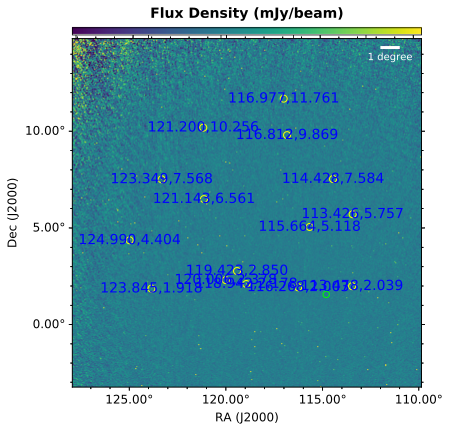

In [43]:
obsid=obsids_157[0]
npoint_cal=100
prefix='src1000_large1'

regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
name='PKS0736+01'
fits_image_filename = '/%s/%s/stokes-%s-%s-I.fits'%(path_157,obsid,obsid,prefix)#sys.argv[1]
fits_file=fits_image_filename.split('/')[-1]

fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS 0736+01')

def_show_markers(fig,skymodeldata_1000_center_4Jy)
def_add_label_loc(fig,skymodeldata_1000_center_4Jy)
#def_add_label_name(fig,skymodeldata_1000_center_4Jy)
#def_show_markers(fig,skymodeldata_1000_center_3Jy)
#def_show_markers(fig,skymodeldata_1000_center)
#fig.savefig('%s/aplpy_img/test/%s_dddd1000_center_4Jy.png'%(path_img,fits_file),dpi=400)

INFO: Auto-setting vmin to -4.519e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.223e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.347e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.784e+02 [aplpy.core]


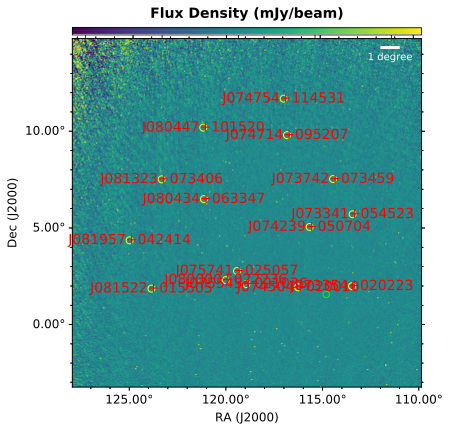

In [44]:
obsid=obsids_157[0]
npoint_cal=100
prefix='src1000_large1'

regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
name='PKS0736+01'
fits_image_filename = '/%s/%s/stokes-%s-%s-I.fits'%(path_157,obsid,obsid,prefix)#sys.argv[1]
fits_file=fits_image_filename.split('/')[-1]

fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS 0736+01')

def_show_markers(fig,skymodeldata_1000_center_4Jy)
#def_add_label_loc(fig,skymodeldata_1000_center_4Jy)
def_add_label_name(fig,skymodeldata_1000_center_4Jy)
#def_show_markers(fig,skymodeldata_1000_center_3Jy)
#def_show_markers(fig,skymodeldata_1000_center)
#fig.savefig('%s/aplpy_img/test/%s_dddd1000_center_4Jy.png'%(path_img,fits_file),dpi=400)

## recenter_test

INFO: Auto-setting vmin to -4.148e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.480e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.681e+02 [aplpy.core]
INFO: Auto-setting vmax to  6.479e+02 [aplpy.core]


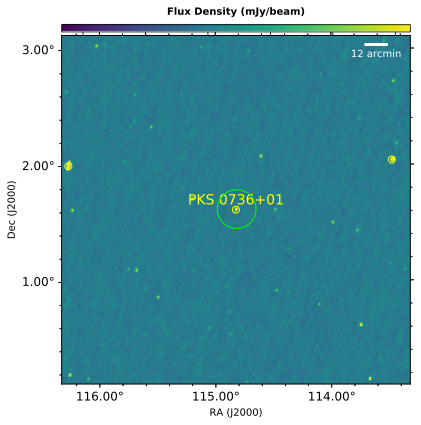

In [53]:
obsid=obsids_157[0]
npoint_cal=100
prefix='src1000_large1'

regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
name='PKS0736+01'
fits_image_filename = '/%s/%s/stokes-%s-%s-I.fits'%(path_157,obsid,obsid,prefix)#sys.argv[1]
fits_file=fits_image_filename.split('/')[-1]


fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS 0736+01',regionsize=1.5)
#fig.show_regions('/share/home/blv/MWAdata/qguo_data/G0044/PKS0736/2018_04_13/PKS0736_nearby.reg')
#fig.show_regions('/share/home/blv/MWAdata/qguo_data/G0044/PKS0736/2018_04_13/PKS0736_src.reg')
#def_show_markers(fig,skymodeldata_1000_1Jy)
#def_add_label_loc(fig,skymodeldata_1000_infield_1Jy)
#def_add_label_loc(fig,skymodeldata_1000_midcenter_1Jy)
#def_add_label_name(fig,skymodeldata_1000_center_4Jy)

def_show_gleam_markers(fig,gleam_select_center_1Jy)
#def_add_gleam_label_loc(fig,gleam_select_center_1Jy)


## 157

### src1000_large1

In [ ]:
size=3000
scale=0.006

for i in range(1,6):  
    obsid=obsids_157[i]
    os.chdir('/share/home/blv/MWAdata/qguo_data/zip/157/%s'%obsid)
    print(os.getcwd())
    os.system('rm *src1000_large1-*')
os.chdir(ipynb_path)     

INFO: Auto-setting vmin to -4.167e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.393e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.563e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.186e+02 [aplpy.core]


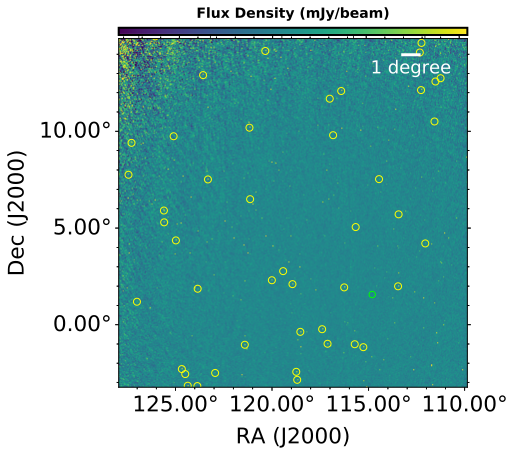

In [373]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-src1000_large1-I.fits'%(obsid,obsid)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    def_show_markers(fig,skymodeldata_1000_4Jy)

INFO: Auto-setting vmin to -4.308e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.783e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.447e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.539e+02 [aplpy.core]


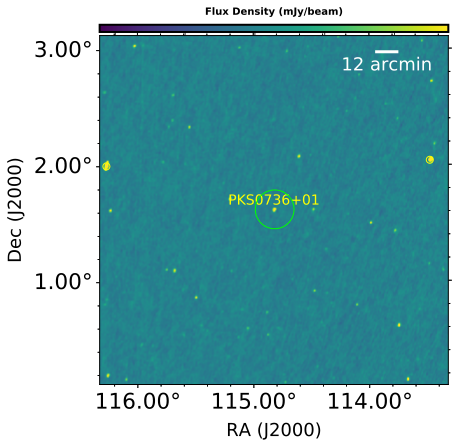

In [374]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large1'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig_path=fits_image_filename[:-4]+'png'
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5)
    #def_show_markers(fig,skymodeldata_100) 
    def_show_markers(fig,gleam_skymodel4Jydata)
    fig.savefig(fig_path,dpi=400)

### selfcal_1

INFO: Auto-setting vmin to -4.133e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.806e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.098e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.435e+02 [aplpy.core]


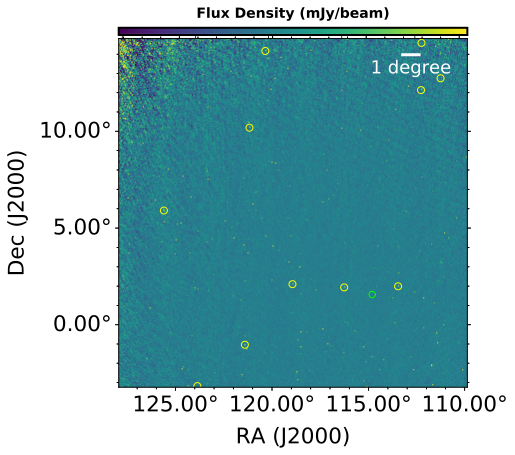

In [375]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='selfcal_1'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig_path=fits_image_filename[:-4]+'png'
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    #def_show_markers(fig,skymodeldata_100) 
    def_show_markers(fig,gleam_skymodel4Jydata)
    #fig.savefig(fig_path,dpi=400)

INFO: Auto-setting vmin to -4.173e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.815e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.207e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.693e+02 [aplpy.core]


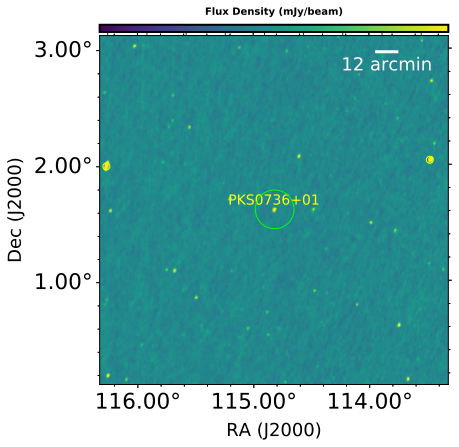

In [376]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='selfcal_1'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig_path=fits_image_filename[:-4]+'png'
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5)
    #def_show_markers(fig,skymodeldata_100) 
    def_show_markers(fig,gleam_skymodel4Jydata)
    fig.savefig(fig_path,dpi=400)

### src1000_large2

In [ ]:
path_plot= '/share/home/blv/MWAdata/qguo_data/zip/157/'
obsids_plot=get_obsids(path_plot)
for i in range(0,6):  
    obsid=obsids_plot[i]
    os.chdir('%s/%s'%(path_plot,obsid))
    print(os.getcwd())   
    os.system('rm *src1000_large2-*')
    
os.chdir(ipynb_path)     

for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large2'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    def_show_markers(fig,skymodeldata_1000) 

### src1000_large3

In [ ]:
size=8000
scale=0.003

In [298]:
16/3600

0.0044444444444444444

INFO: Auto-setting vmin to -2.098e+03 [aplpy.core]
INFO: Auto-setting vmax to  2.461e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.546e+03 [aplpy.core]
INFO: Auto-setting vmax to  2.102e+03 [aplpy.core]


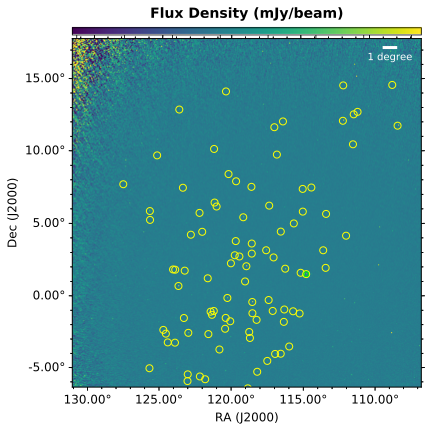

In [61]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large3'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large3//%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    def_show_markers(fig,skymodeldata_100) 

INFO: Auto-setting vmin to -1.440e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.942e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.888e+03 [aplpy.core]
INFO: Auto-setting vmax to  2.259e+03 [aplpy.core]


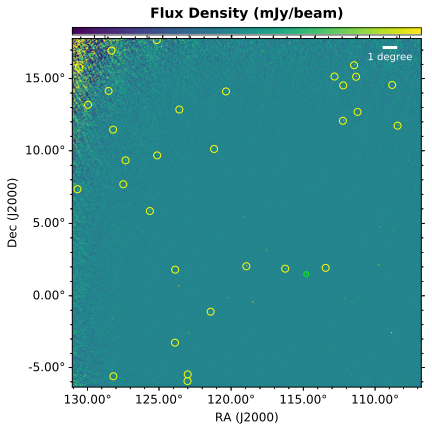

In [62]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large3'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large3//%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    def_show_gleam_markers(fig,gleam_large_center1_4Jy) 

INFO: Auto-setting vmin to -1.710e+03 [aplpy.core]
INFO: Auto-setting vmax to  2.132e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.879e+03 [aplpy.core]
INFO: Auto-setting vmax to  2.195e+03 [aplpy.core]


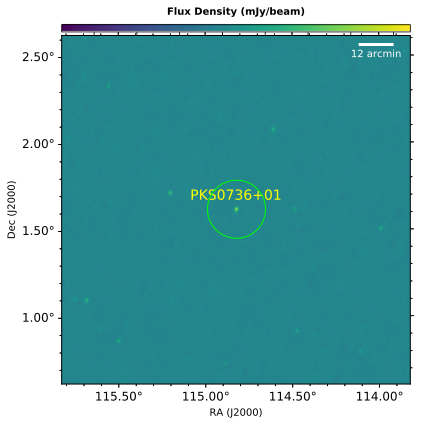

In [63]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large3'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large3//%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]  
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1)
    def_show_gleam_markers(fig,gleam_large_center1_4Jy)

INFO: Auto-setting vmin to -1.718e+03 [aplpy.core]
INFO: Auto-setting vmax to  2.212e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.712e+03 [aplpy.core]
INFO: Auto-setting vmax to  2.403e+03 [aplpy.core]


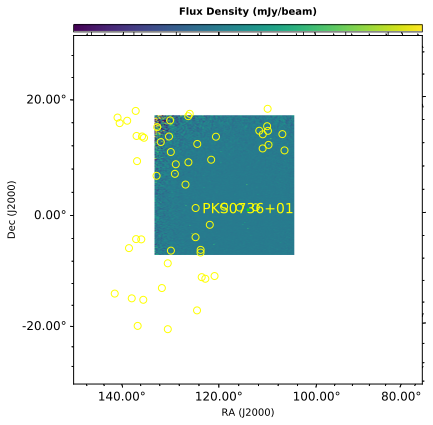

In [66]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large3'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large3//%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))  
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=30)
    #def_show_markers(fig,skymodeldata_100) 
    def_show_gleam_markers(fig,gleam_large_center1_4Jy)

### src1000_large4

In [ ]:
size=10000
scale=0.003

for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large4'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large4//%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    print(len(skymodeldata_1000_midcenter_1Jy))
    
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=10)
    #def_show_markers(fig,skymodeldata_100) 
    def_show_markers(fig,gleam_skymodel4Jydata)

### src1000_large5

In [ ]:
size=4096
scale=0.0045

In [377]:
16/3600

0.0044444444444444444

In [301]:
32/3600,16/3600,1.6/60#MWA phaseI ; phaseII extended;phaseII compact

(0.008888888888888889, 0.0044444444444444444, 0.02666666666666667)

In [ ]:
0.003*3600

In [ ]:
1.6/60

INFO: Auto-setting vmin to -4.735e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.919e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.773e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.478e+02 [aplpy.core]


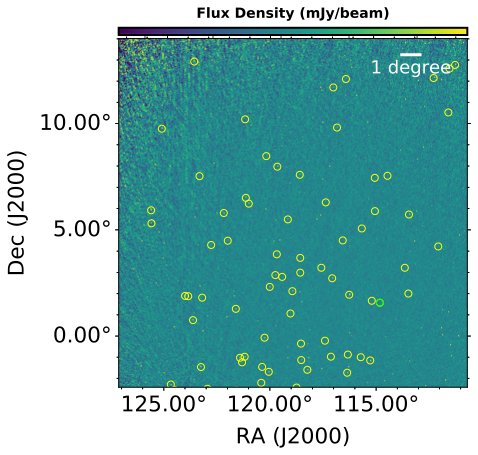

In [380]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large5'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large5/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    #fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=3.5)
    def_show_markers(fig,skymodeldata_100) 
    #def_show_markers(fig,gleam_skymodel4Jydata)

19
INFO: Auto-setting vmin to -4.696e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.860e+02 [aplpy.core]
INFO: Auto-setting vmin to -5.380e+02 [aplpy.core]
INFO: Auto-setting vmax to  5.418e+02 [aplpy.core]


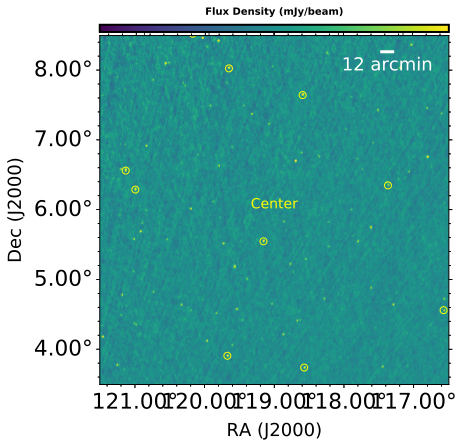

In [388]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large5'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large5/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    print(len(skymodeldata_1000_midcenter_1Jy))
    
    fig=plot_image_recenter(fits_image_filename,regfile,ra=119,dec=6,name='Center',regionsize=2.5)
    def_show_markers(fig,skymodeldata_100) 
    #def_show_markers(fig,gleam_skymodel4Jydata)

INFO: Auto-setting vmin to -4.518e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.930e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.156e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.577e+02 [aplpy.core]


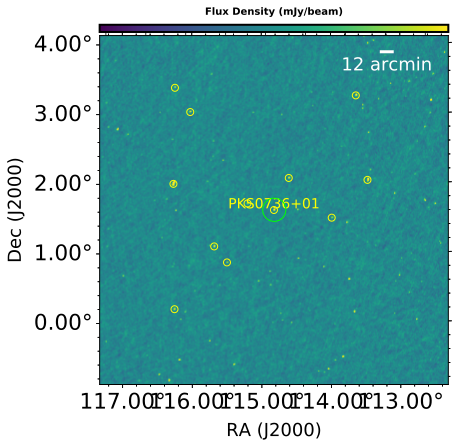

In [389]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large5'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large5/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=2.5)
    #def_show_markers(fig,skymodeldata_100) 
    #def_show_markers(fig,gleam_skymodel4Jydata)    
    #def_show_gleam_markers(fig,gleam_select_infield)
    def_show_gleam_markers(fig,gleam_select_infield_0dot5Jy)

### src1000_large6

In [ ]:
size=4096
scale=0.003

0 1207652304
INFO: Auto-setting vmin to -3.119e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.854e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.921e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.130e+02 [aplpy.core]
1 1207652904
INFO: Auto-setting vmin to -2.469e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.127e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.600e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.163e+02 [aplpy.core]
2 1207654104
INFO: Auto-setting vmin to -2.579e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.357e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.710e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.613e+02 [aplpy.core]
3 1207654704
INFO: Auto-setting vmin to -2.437e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.917e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.375e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.266e+02 [aplpy.core]
4 1207655904
INFO: Auto-setting vmin to -2.802e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.638e+02 [aplpy.core]
INFO: Auto-settin

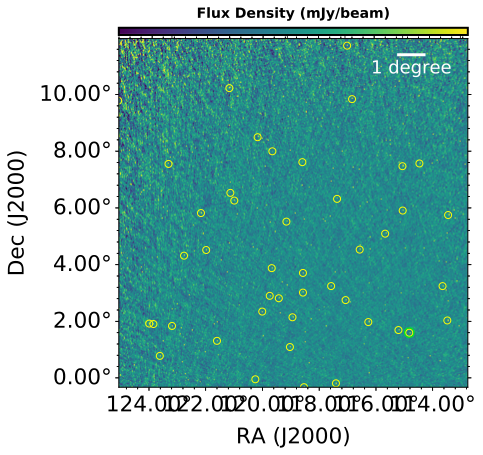

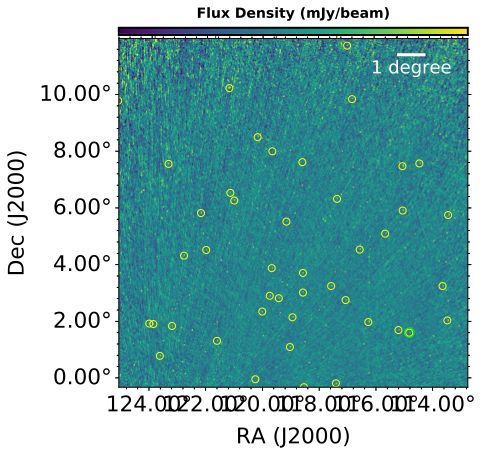

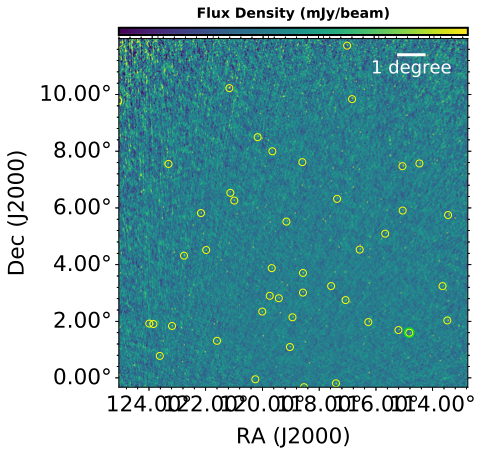

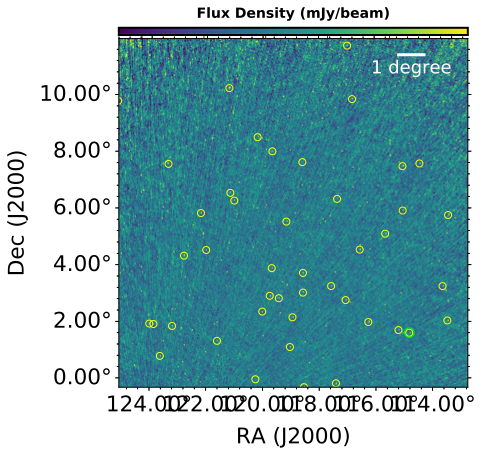

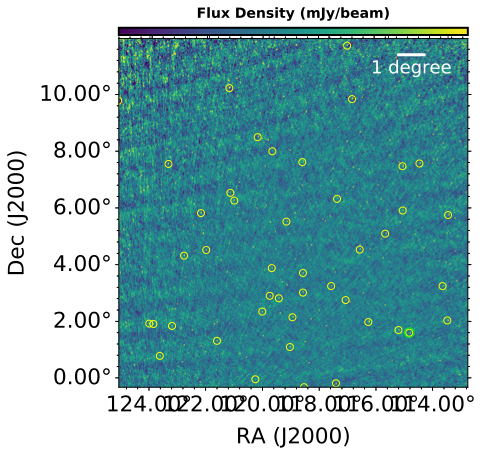

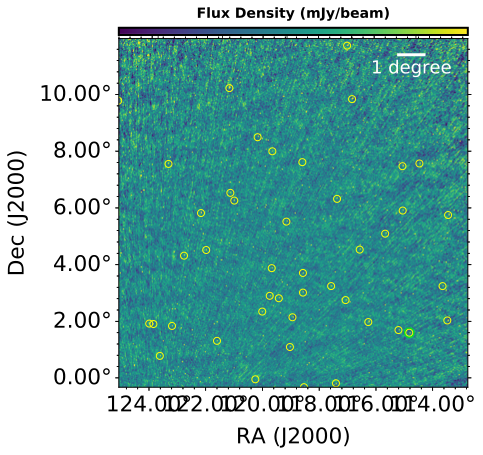

In [365]:
for i in range(6):   
    obsid=obsids_157[i]
    print(i,obsid)
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large6'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large6/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    #fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=3.5)
    def_show_markers(fig,skymodeldata_100) 
    #def_show_markers(fig,gleam_skymodel4Jydata)

0 1207652304
INFO: Auto-setting vmin to -2.869e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.106e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.865e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.353e+02 [aplpy.core]
1 1207652904
INFO: Auto-setting vmin to -2.549e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.921e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.647e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.053e+02 [aplpy.core]
2 1207654104
INFO: Auto-setting vmin to -2.618e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.206e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.685e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.142e+02 [aplpy.core]
3 1207654704
INFO: Auto-setting vmin to -2.490e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.030e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.386e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.786e+02 [aplpy.core]
4 1207655904
INFO: Auto-setting vmin to -2.650e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.495e+02 [aplpy.core]
INFO: Auto-settin

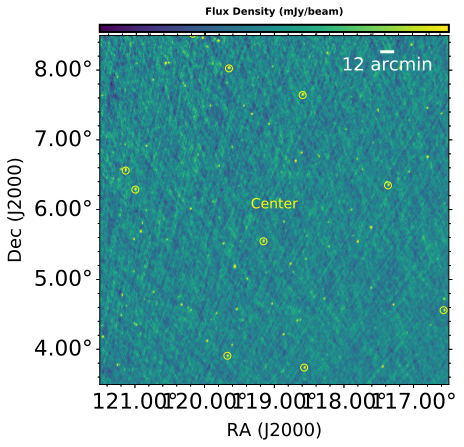

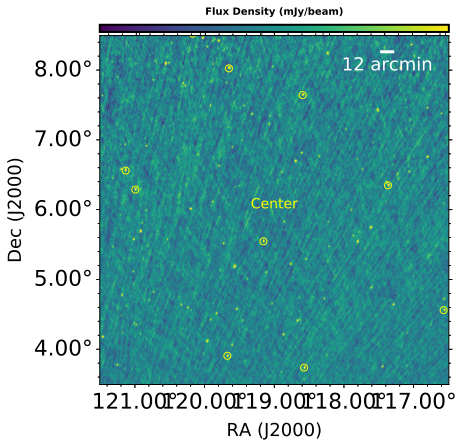

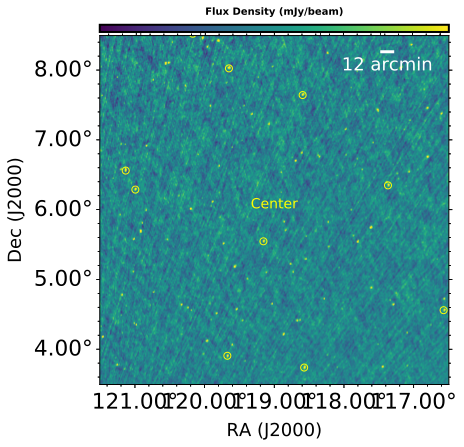

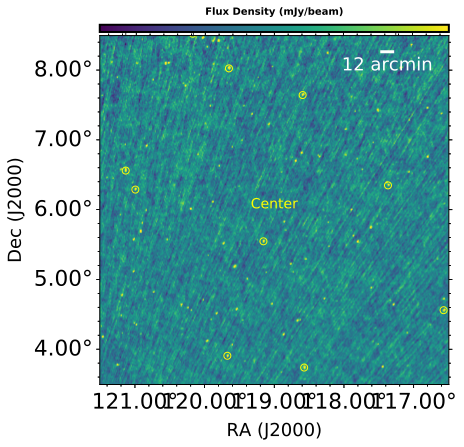

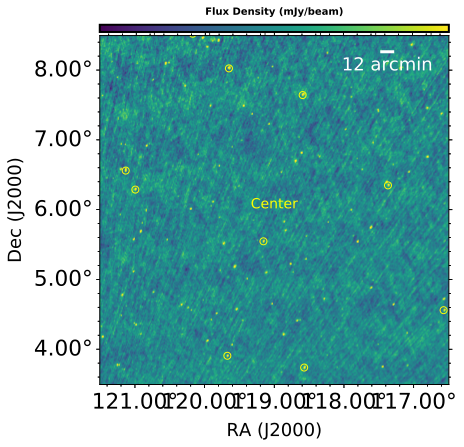

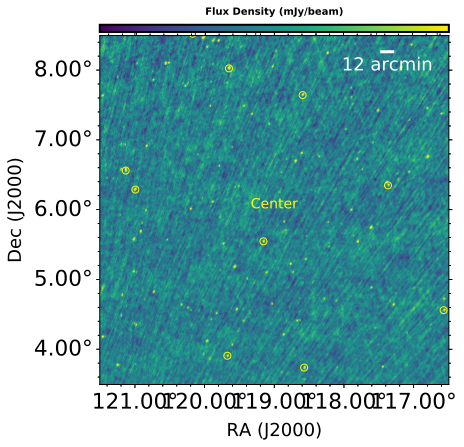

In [366]:
for i in range(6):   
    obsid=obsids_157[i]
    print(i,obsid)
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large6'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large6/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    
    fig=plot_image_recenter(fits_image_filename,regfile,ra=119,dec=6,name='Center',regionsize=2.5)
    def_show_markers(fig,skymodeldata_100) 
    #def_show_markers(fig,gleam_skymodel4Jydata)

INFO: Auto-setting vmin to -3.132e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.184e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.845e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.364e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.699e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.592e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.574e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.048e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.690e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.404e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.565e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.083e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.474e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.936e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.406e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.223e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.672e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.615e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.672e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.5

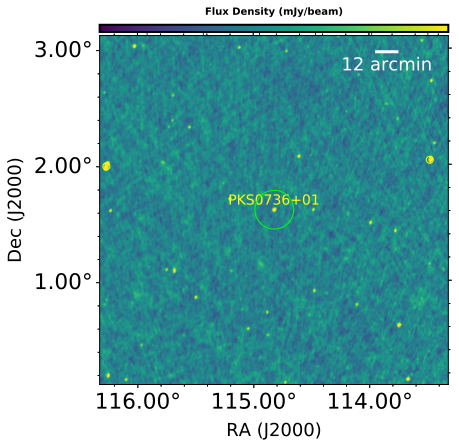

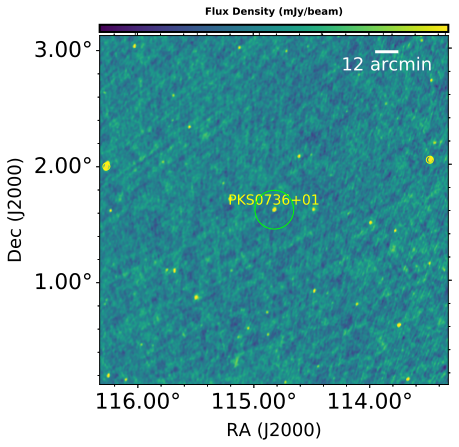

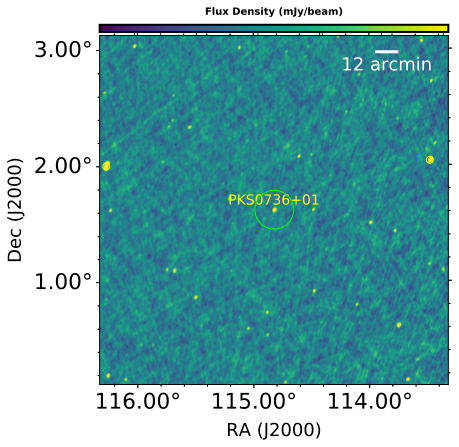

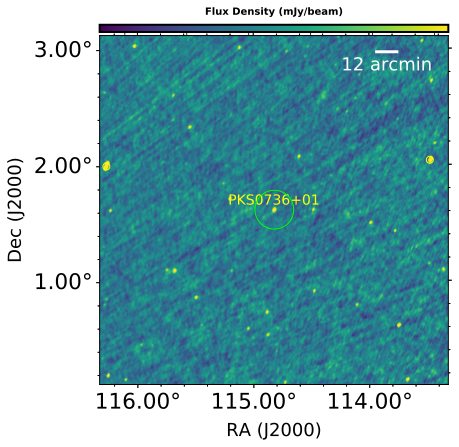

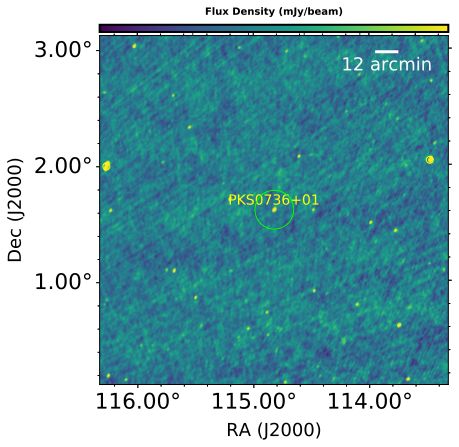

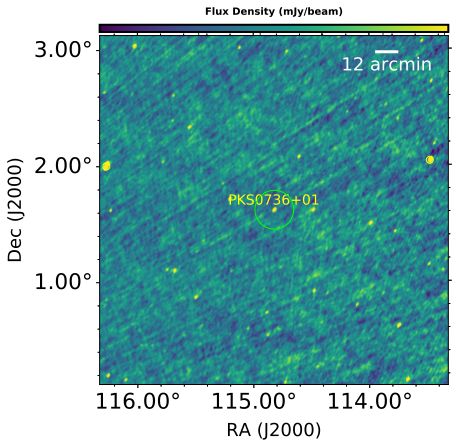

In [368]:
for i in range(6):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large6'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large6//%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5)
    #def_show_markers(fig,skymodeldata_100) 
    def_show_markers(fig,gleam_skymodel4Jydata)

### selfcal_6

INFO: Auto-setting vmin to -2.705e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.026e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.470e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.052e+02 [aplpy.core]


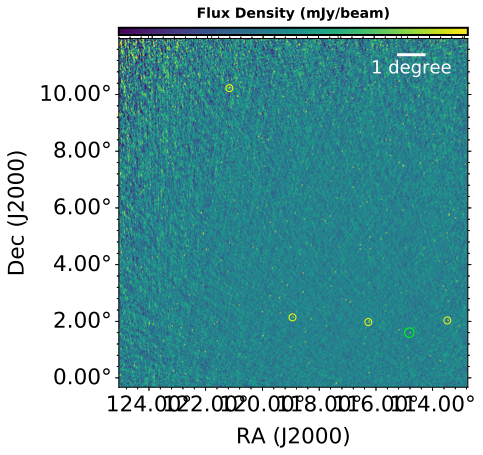

In [369]:
for i in range(1):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='selfcal_6'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large6//%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig_path=fits_image_filename[:-4]+'png'
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    #def_show_markers(fig,skymodeldata_100) 
    def_show_markers(fig,gleam_skymodel4Jydata)
    #fig.savefig(fig_path,dpi=400)

0 1207652304
INFO: Auto-setting vmin to -2.453e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.399e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.621e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.800e+02 [aplpy.core]
1 1207652904
INFO: Auto-setting vmin to -2.220e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.491e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.233e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.841e+02 [aplpy.core]
2 1207654104
INFO: Auto-setting vmin to -2.388e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.143e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.384e+02 [aplpy.core]
INFO: Auto-setting vmax to  3.018e+02 [aplpy.core]
3 1207654704
INFO: Auto-setting vmin to -2.331e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.860e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.335e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.634e+02 [aplpy.core]
4 1207655904
INFO: Auto-setting vmin to -4.536e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.757e+02 [aplpy.core]
INFO: Auto-settin

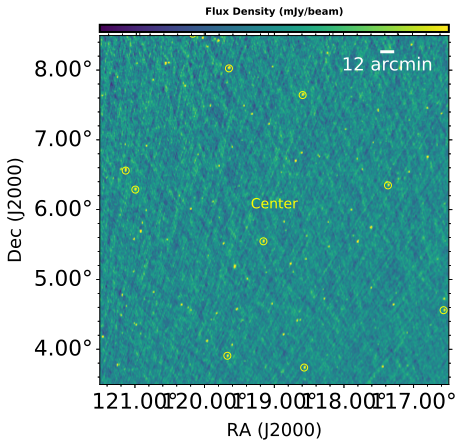

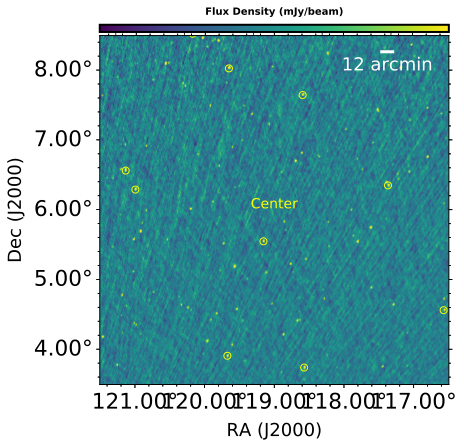

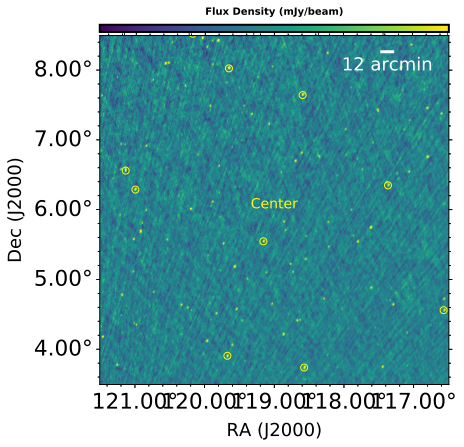

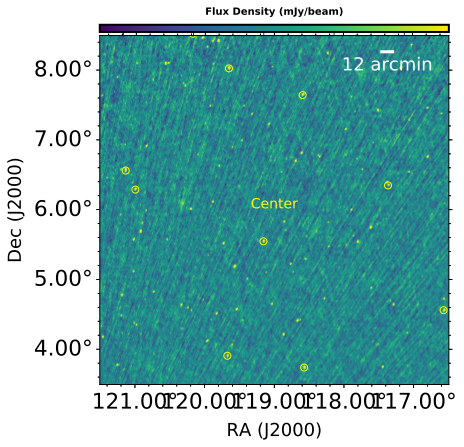

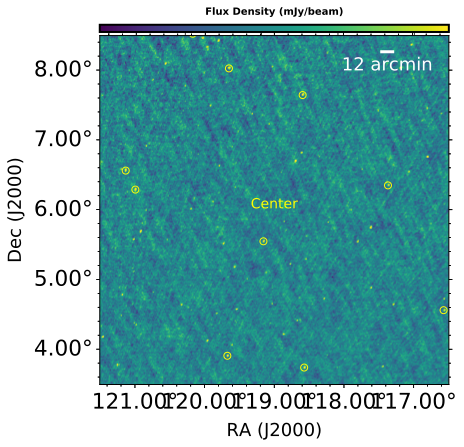

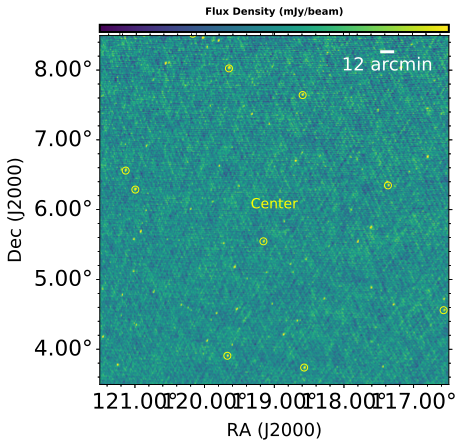

In [371]:
for i in range(6):   
    obsid=obsids_157[i]
    print(i,obsid)
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='selfcal_6'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large6/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    
    fig=plot_image_recenter(fits_image_filename,regfile,ra=119,dec=6,name='Center',regionsize=2.5)
    def_show_markers(fig,skymodeldata_100) 
    #def_show_markers(fig,gleam_skymodel4Jydata)

### sol_database

for i in range(5):  
    obsid=obsids_157[i]
    os.chdir('/share/home/blv/MWAdata/qguo_data/zip/157/%s'%obsid)
    print(os.getcwd())
    os.system('rm *-sol_database-*')
os.chdir(ipynb_path) 

In [ ]:
for i in range(5):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-sol_database-I.fits'%(obsid,obsid)#sys.argv[1]
    print(len(skymodeldata_1000_midcenter_1Jy))
    plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')

for i in range(5):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-sol_database-I.fits'%(obsid,obsid)#sys.argv[1]
    print(len(skymodeldata_1000_midcenter_1Jy))
    plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5)

for i in range(5):   
    obsid=obsids_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/%s/stokes-%s-sol_database-I.fits'%(obsid,obsid)#sys.argv[1]
    print(len(skymodeldata_1000_midcenter_1Jy))
    plot_image_recenter(fits_image_filename,regfile,ra=115.73,dec=1.859,name='Center',regionsize=1.5)

## nan_157

### src1000_large1

In [ ]:
size=3000
scale=0.006

INFO: Auto-setting vmin to -2.256e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.438e+02 [aplpy.core]
INFO: Auto-setting vmin to -2.270e+02 [aplpy.core]
INFO: Auto-setting vmax to  2.365e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.180e+01 [aplpy.core]
INFO: Auto-setting vmax to  5.656e+01 [aplpy.core]
INFO: Auto-setting vmin to -4.211e+01 [aplpy.core]
INFO: Auto-setting vmax to  5.847e+01 [aplpy.core]


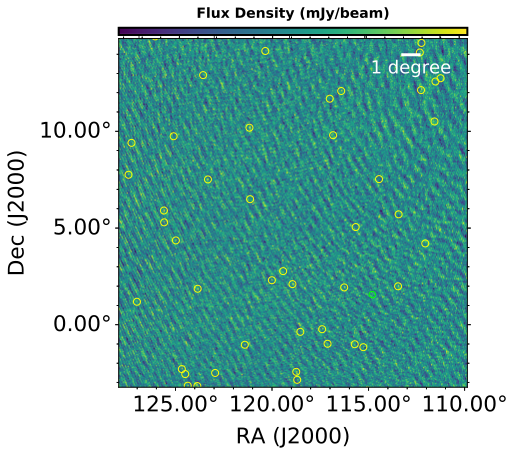

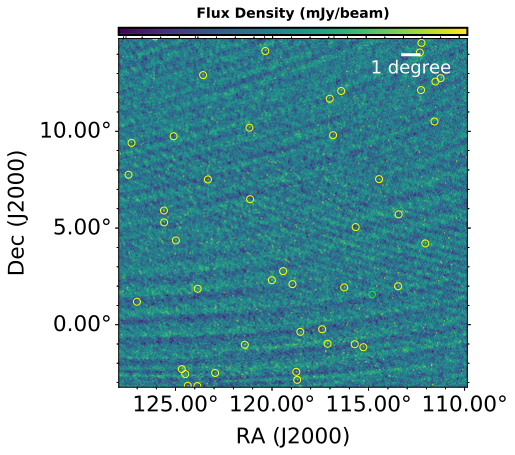

In [284]:
for i in range(6,8):   
    obsid=obsids_nan_path_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large1'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/%s/%s_%s-XX-image.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    def_show_markers(fig,skymodeldata_1000_4Jy)  

INFO: Auto-setting vmin to -1.879e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.672e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.497e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.561e+03 [aplpy.core]
INFO: Auto-setting vmin to -3.694e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.731e+02 [aplpy.core]
INFO: Auto-setting vmin to -3.973e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.666e+02 [aplpy.core]


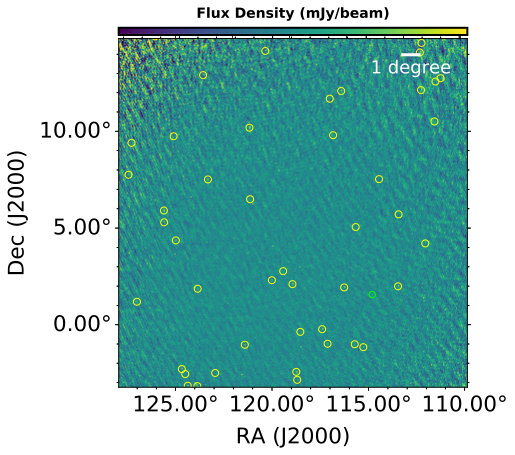

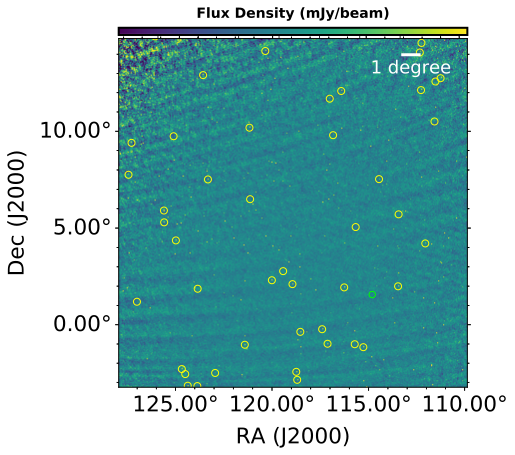

In [283]:
for i in range(6,8):   
    obsid=obsids_nan_path_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large1'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    def_show_markers(fig,skymodeldata_1000_4Jy)  

In [ ]:
for i in range(1):   
    obsid=obsids_nan_path_157[i]
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large1'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_recenter(fits_image_filename,regfile,ra=120,dec=5,name='',regionsize=1.5)
    def_show_markers(fig,skymodeldata_1000_4Jy)  

6 1208777832
INFO: Auto-setting vmin to -1.606e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.630e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.616e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.770e+03 [aplpy.core]
7 1209120696
INFO: Auto-setting vmin to -3.713e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.869e+02 [aplpy.core]
INFO: Auto-setting vmin to -4.056e+02 [aplpy.core]
INFO: Auto-setting vmax to  4.518e+02 [aplpy.core]


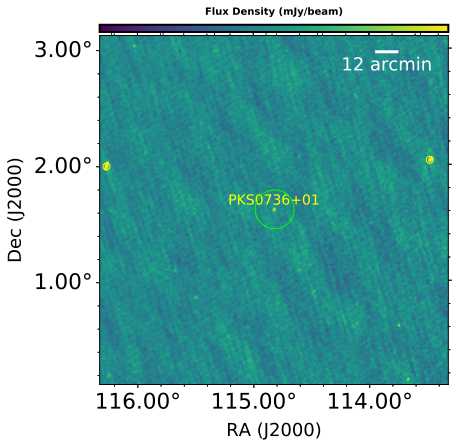

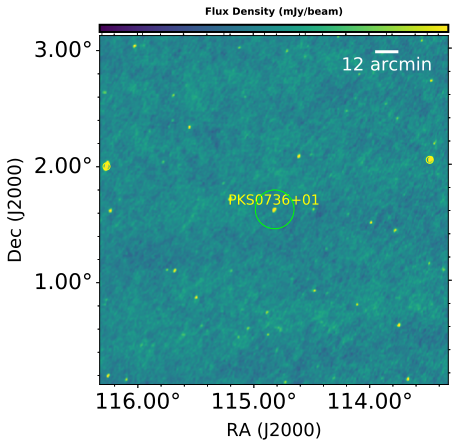

In [282]:
for i in range(6,8):   
    obsid=obsids_nan_path_157[i]
    print(i,obsid)
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large1'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5)
    def_show_markers(fig,skymodeldata_1000_4Jy)  

### src1000_large3

In [ ]:
size=8000
scale=0.003

6 1208777832
INFO: Auto-setting vmin to -1.494e+04 [aplpy.core]
INFO: Auto-setting vmax to  1.647e+04 [aplpy.core]
INFO: Auto-setting vmin to -1.601e+04 [aplpy.core]
INFO: Auto-setting vmax to  1.474e+04 [aplpy.core]
7 1209120696
INFO: Auto-setting vmin to -1.553e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.404e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.201e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.511e+03 [aplpy.core]


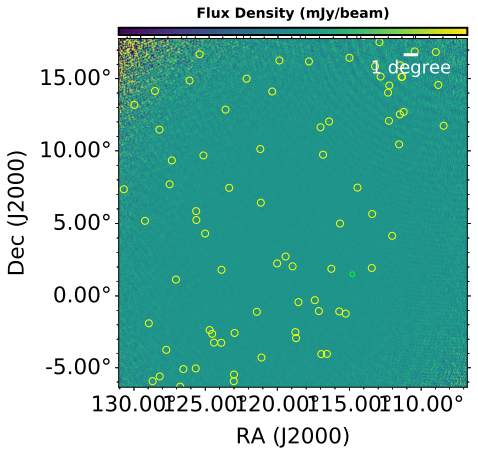

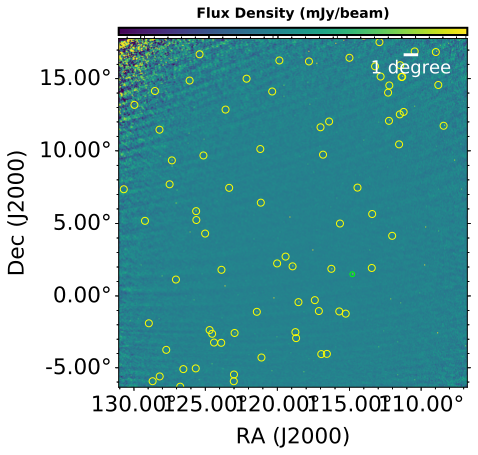

In [281]:
for i in range(6,8):   
    obsid=obsids_nan_path_157[i]
    print(i,obsid)
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large3'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    #print(len(skymodeldata_1000_midcenter_1Jy))
    fig=plot_image_dddd(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01')
    def_show_markers(fig,skymodeldata_1000_4Jy)  

6 1208777832
INFO: Auto-setting vmin to -1.368e+04 [aplpy.core]
INFO: Auto-setting vmax to  1.347e+04 [aplpy.core]
INFO: Auto-setting vmin to -1.570e+04 [aplpy.core]
INFO: Auto-setting vmax to  1.461e+04 [aplpy.core]
7 1209120696
INFO: Auto-setting vmin to -1.257e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.442e+03 [aplpy.core]
INFO: Auto-setting vmin to -1.146e+03 [aplpy.core]
INFO: Auto-setting vmax to  1.564e+03 [aplpy.core]


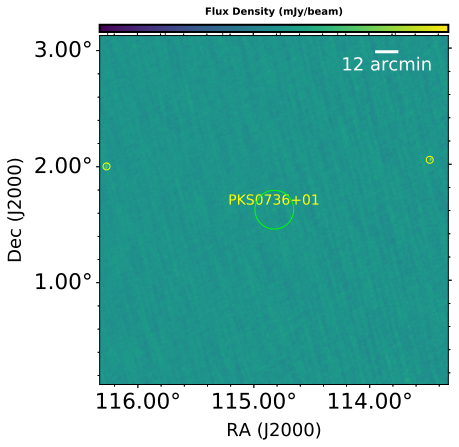

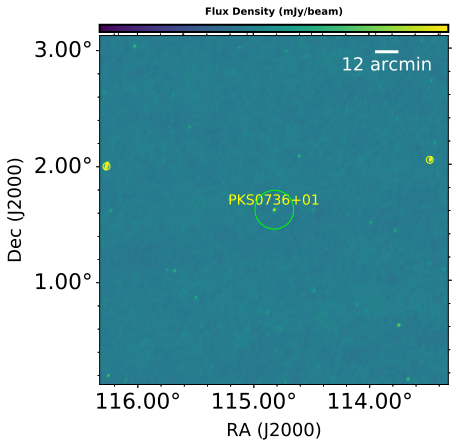

In [280]:
for i in range(6,8):   
    obsid=obsids_nan_path_157[i]
    print(i,obsid)
    regfile='/share/home/blv/mwa_code_py/PKS0736_src.reg'
    name='PKS0736+01'
    prefix='src1000_large3'
    fits_image_filename = '/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/%s/stokes-%s-%s-I.fits'%(obsid,obsid,prefix)#sys.argv[1]
    fig=plot_image_recenter(fits_image_filename,regfile,ra=114.825,dec=1.618,name='PKS0736+01',regionsize=1.5)
    def_show_markers(fig,skymodeldata_1000_4Jy)  

## rm prefix

path_plot= '/share/home/blv/MWAdata/qguo_data/zip/157/nan_157/'
obsids_plot=get_obsids(path_plot)
for i in range(8):  
    obsid=obsids_plot[i]
    os.chdir('%s/%s'%(path_plot,obsid))
    print(os.getcwd())   
    os.system('rm *peel4Jy-*')
os.chdir(ipynb_path)     

In [117]:
0.006*3600,0.003*3600,0.001*3600

(21.6, 10.8, 3.6)

In [119]:
0.005*3600

18.0

## plt_skymodel

Text(0, 0.5, 'DEC')

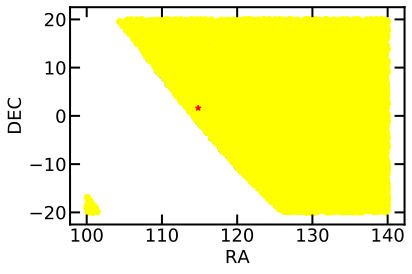

In [114]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

ax.scatter(skymodeldata_1000['ra'],skymodeldata_1000['dec'],zorder=0)
ax.scatter(gleam_large_center1['RAJ2000'],gleam_large_center1['DEJ2000'],color='yellow',zorder=1)

plt.plot(114.825,1.618,marker='*',zorder=2,color='r')

set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2         
plt.xlabel('RA')
plt.ylabel('DEC')
#plt.xlim(140,100)

# casa_plotms

## listobs

In [ ]:
import os
datadir=os.getcwd()
obsnum=datadir.split('/')[-1]
obsid=int(obsnum)
vis='%s.ms'%obsnum
listobs(vis=vis,listfile='%d.ms.listfile.txt'%obsid)
plotants(vis=vis,figfile='ants_%s.ms.png'%obsid)

In [ ]:
clearstat() # This removes any existing table locks generated by flagdata
plotms(vis=vis,xaxis='uvwave',yaxis='amp',
       ydatacolumn='data',correlation='XX',
       averagedata=True, avgchannel='64', 
      )

## flag data

In [ ]:
flagdata(vis=vis,mode='tfcrop',correlation='',freqfit='line',extendflags=False,flagbackup=False,datacolumn='corrected',flagdimension='freq',ntime='scan')
flagdata(vis=vis,mode='rflag',correlation='',extendflags=True,flagbackup=False,datacolumn='corrected',ntime='scan')

In [ ]:
flagdata(vis=vis, flagbackup=False, mode='manual', antenna='46&48')
flagdata(vis=vis, flagbackup=False, mode='manual', antenna='42&48',spw='0:704~767') 
flagdata(vis=vis, flagbackup=False, mode='manual', antenna='27&29')

In [ ]:
flagsum = flagdata(vis=vis, mode='summary')
percent=flagsum["observation"]['0']['flagged']/flagsum["observation"]['0']['total']
print(percent)

execfile('casa_plot_argv.py')

## plotms

In [ ]:
import os

def get_obsids(path):
    dirname=os.listdir(path)
    obsids=[]
    for i in dirname:
        if i.isdigit():
            obsids.append(i)
    obsids.sort()        
    return obsids

#casaimg='/share/home/blv/MWAdata/qguo_data/casa_img/'
path_157='/share/home/blv/MWAdata/qguo_data/zip/157/'
obsnums=get_obsids(path_157)
print(len(obsnums))

for i in range(0,len(obsnums)):#len(obsnums)   
    obsnum=obsnums[i]
    msfile_1='%s'%obsnum
    print(obsnum)
    msfile_path=os.path.join(path_157,obsnum,msfile_1+'.ms')
    vis=msfile_path
    
    chan_amp_png_path=os.path.join(path_157,obsnum,msfile_1+'chan_amp.png')
    uvwave_amp_png_path=os.path.join(path_157,obsnum,msfile_1+'uvwave_amp.png')   
    
    #base_amp_png_path=os.path.join(path_157,obsnum,msfile_1+'base_amp.png')
    freq_amp_png_path=os.path.join(path_157,obsnum,msfile_1+'freq_amp.png') 
    
    if not os.path.exists(freq_amp_png_path):
        plotms(vis=vis, selectdata=True, correlation='XX', xaxis='frequency',yaxis='amp',showgui=False,plotfile=freq_amp_png_path,overwrite=True)   
    if not os.path.exists(chan_amp_png_path):
        plotms(vis=vis, selectdata=True, correlation='XX', xaxis='channel',yaxis='amp',  showgui=False,plotfile=chan_amp_png_path,overwrite=True)
    #if not os.path.exists(base_amp_png_path):
        #plotms(vis=vis, selectdata=True, correlation='XX', xaxis='baseline',yaxis='amp', showgui=False,plotfile=base_amp_png_path,overwrite=True)
    if not os.path.exists(uvwave_amp_png_path):
        plotms(vis=vis, selectdata=True, correlation='XX', xaxis='uvwave',yaxis='amp', showgui=False,plotfile=uvwave_amp_png_path,overwrite=True)


# cellsize

In [ ]:
lamda=2300
print(180*3600/np.pi/lamda)
print(180*3600/np.pi/lamda/3,180*3600/np.pi/lamda/5)
print(180/np.pi/lamda/3,180/np.pi/lamda/5)

In [ ]:
lamda=4000
print(180*3600/np.pi/lamda)
print(180*3600/np.pi/lamda/3,180*3600/np.pi/lamda/5)
print(180/np.pi/lamda/3,180/np.pi/lamda/5)

In [ ]:
59*7000/3600

# cal2_wsclean_beam

# Aegean

In [105]:
def get_imagefile_of_obsid(path,obsid,prefix):
    obsid_path=os.path.join(path,obsid)
    files = os.listdir(obsid_path)
    imgfile= os.path.join(path,obsid,'stokes-%s-%s-I.fits'%(obsid,prefix)) 
    if os.path.exists(imgfile):    
        return imgfile
    else:
        return False
    
def get_aegean_table_of_obsid(path,obsid,prefix,imgfile):
    os.chdir(os.path.join(path,obsid))
    print(os.path.join(path,obsid))  
    if not os.path.exists('stokes-%s-%s-I_out_comp.fits'%(obsid,prefix)):
        bane_com='BANE %s'%imgfile
        print(bane_com)
        os.system(bane_com)
        aegean_com='aegean --autoload %s'%imgfile+ ' --table %s_out.fits'%imgfile[:-5]
        print(aegean_com)
        os.system(aegean_com)
        print()
    else:
        print('bane done for ',obsid)    
        
def bane_aegean_for_path(path,prefix):
    obsids=get_obsids(path)
    for i in range(0,len(obsids)):#len(obsnums)
        obsid=obsids[i]
        imgfile=get_imagefile_of_obsid(path,obsid,prefix)     
        if imgfile:
            hdl_stokes_I=fits.open(imgfile)
            if not math.isnan(hdl_stokes_I[0].data[0][0][0][0]):
                get_aegean_table_of_obsid(path,obsid,prefix,imgfile)
            else:
                print('nan_Img for',obsid)
        #fits_image_filename=os.path.join(datadir,obsnum,img)        

In [ ]:
bane_aegean_for_path(path_157,'briggsplus1')

bane_aegean_for_path(src1000_large3_path,'src1000_large3')

## check_bane_aegean_for_path

In [103]:
def check_bane_aegean_for_path(path,prefix='briggsplus1'):
    obsids=get_obsids(path)
    for i in range(0,len(obsids)):#len(obsnums)
        obsid=obsids[i]
        imgfile=get_imagefile_of_obsid(path,obsid,prefix)
        if imgfile:
            hdl_stokes_I=fits.open(imgfile)
            if os.path.exists(os.path.join(path,obsid,'stokes-%s-%s-I_out_comp.fits'%(obsid,prefix))):
                print('bane done for %s'%obsid)
                
            else:
                if not math.isnan(hdl_stokes_I[0].data[0][0][0][0]):
                    print('doing bane for',obsid)
                    
                else:
                    print('nan_Img for',obsid)
                    
        else:
            print('no stokes img for',obsid)
        #fits_image_filename=os.path.join(datadir,obsnum,img)   

In [ ]:
check_bane_aegean_for_path(path_157,prefix='src1000_large1')   

In [106]:
check_bane_aegean_for_path(nan_path_157,prefix='briggsplus1') 

nan_Img for 1207742064
nan_Img for 1208086720
nan_Img for 1208345216
nan_Img for 1208431376
nan_Img for 1208515744
nan_Img for 1208776032
nan_Img for 1208777832
nan_Img for 1209120696


# lightcurve

## corlors_band_freq

In [67]:
from pylab import cm

bands_all=[87, 118, 154, 184, 215]
bands_all=sorted(bands_all)
colors_cm_10 = cm.get_cmap('tab10', 10)
corlors_band=[colors_cm_10(0),colors_cm_10(2),colors_cm_10(3),colors_cm_10(4),colors_cm_10(9)]
color_dict_band= dict(zip(bands_all, corlors_band))

## table

In [68]:
def get_table_file(path,obsid,prefix):
    obsid_path=os.path.join(path,obsid)
    imgfile = os.path.join(obsid_path,'stokes-%s-%s-I_out_comp.fits'%(obsid,prefix))   
    if os.path.exists(imgfile):
        return imgfile
    else:
        return False

def read_tables(path,obsid,prefix):
    table_name=get_table_file(path,obsid,prefix)
    
    if table_name: 
        table = Table.read(table_name)
        #print(table_PKS0736)
        return table
    else:
        return False
    
def get_stokes_image_freq_err_of_obsid(path,obsid,prefix='briggsplus1'):  
    stokes_file_I=os.path.join(path,obsid,'stokes-%s-%s-I.fits'%(obsid,prefix))
    if os.path.exists(stokes_file_I):      
        hdl_stokes_I=fits.open(stokes_file_I)            
        return stokes_file_I,int(hdl_stokes_I[0].header['CRVAL3']*u.Hz.to(u.MHz)),hdl_stokes_I[0].header['CDELT3']*u.Hz.to(u.MHz)
    else:
        return False,0,0 

## return_table_of_onesource

In [69]:
def return_table_of_onesource(path,ra=114.825,dec=1.618,prefix='briggsplus1'):
    obsnums=get_obsids(path)
    no_select_obsids=[]
    no_table_obsids=[]
    with_noise_obsids=[]
    df_ = pd.DataFrame(columns=["obsid", "mjd", "freq","flux","flux_err","peak_flux","err_peak_flux"])
    
    #mjd0=Time(obsnums[0], format='gps').mjd
    #intmjd0=math.floor(mjd0)  
    
    for obsid in obsnums:              
        stokes_file_I,freq_central,freq_delta=get_stokes_image_freq_err_of_obsid(path,obsid,prefix)
        freq=int(freq_central)        

        table_=read_tables(path,obsid,prefix)
        if table_:
            select_=table_[abs(table_['ra']-ra)<0.01]
            select_=select_[abs(select_['dec']-dec)<0.01] 
            
            if len(select_)>0:  
                mjd=Time(obsid, format='gps').mjd
                #mjdtime_frac=mjd-intmjd0                
                #date_obs=mjd2datetimenew(mjd)
                #print(date_obs)
                flux=select_['int_flux'].quantity[0]
                flux_err=select_['err_int_flux'].quantity[0]
                peak_flux=select_['peak_flux'].quantity[0] 
                err_peak_flux=select_['err_peak_flux'].quantity[0] 
                color=color_dict_band[freq]
                
                #if mjdtime_frac<2:
                #ax.errorbar(mjdtime_frac*24,flux,yerr=flux_err,marker='.',color=color,label=str(freq))
                
                if flux_err>0 and flux_err<1.0:               
                    df_=df_.append(
                        pd.Series({"obsid":obsid, "mjd":mjd,"freq":freq,
                        "flux":flux,"flux_err":flux_err,
                        "peak_flux":peak_flux,"err_peak_flux":err_peak_flux,
                        "ra":ra,"dec":dec}), 
                        ignore_index=True)                
                else:
                    #ax.text(mjdtime_frac*24,flux,str(obsid))
                    with_noise_obsids.append(obsid)                    
            #print(obsid,freq_central,select_['int_flux'].quantity[0],select_['err_int_flux'].quantity[0])
            #print('****************************************')
               
            else:
                no_select_obsids.append(obsid)
        else:
            no_table_obsids.append(obsid)
            
    return no_table_obsids,no_select_obsids, with_noise_obsids,df_

In [ ]:
gleam_PKS0736['int_flux_212'],gleam_PKS0736['err_int_flux_212']

In [ ]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
name_=skymodeldata_1000_infield_1Jy['Name'][2]

for j in range(0,len(df_)):
    color=color_dict_band[df_['freq'][j]]
    ax.errorbar((df_['mjd'][j]-intmjd0)*24*60,df_['flux'][j],yerr=df_['flux_err'][j],
                                marker='.',color=color,
                                label=df_['freq'][j])
    #ax.text((df_['mjd'][j]-intmjd0)*24*60,df_['flux'][j],df_['obsid'][j])
    
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_212'],color='r',ls='--',lw=2)
    ax.text(1.0, 0.9, 'gleam 212 MHz %.2fJy'%gleam_PKS0736['int_flux_212'][0], 
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(1.0, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]), 
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')

set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2         
plt.xlabel('minute')

In [ ]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
name_=skymodeldata_1000_infield_1Jy['Name'][2]

for j in range(0,12):
    color=color_dict_band[df_['freq'][j]]
    ax.errorbar((df_['mjd'][j]-intmjd0)*24,df_['flux'][j],yerr=df_['flux_err'][j],
                                marker='.',color=color,
                                label=df_['freq'][j])
    ax.text((df_['mjd'][j]-intmjd0)*24,df_['flux'][j],df_['obsid'][j])
    
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_212'],color='r',ls='--',lw=2)
    ax.text(1.0, 0.9, 'gleam 212 MHz %.2fJy'%gleam_PKS0736['int_flux_212'][0], 
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(1.0, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]), 
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')

set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2         
plt.xlabel('minute')       
plt.xlabel('hour')

In [ ]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
name_=skymodeldata_1000_infield_1Jy['Name'][2]

for j in range(0,12):
    color=color_dict_band[df_['freq'][j]]
    ax.errorbar((df_['mjd'][j]-intmjd0),df_['flux'][j],yerr=df_['flux_err'][j],
                                marker='.',color=color,
                                label=df_['freq'][j])
    ax.text((df_['mjd'][j]-intmjd0),df_['flux'][j],df_['obsid'][j])
    
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_212'],color='r',ls='--',lw=2)
    ax.text(1.2, 0.9, 'gleam 212 MHz %.2fJy'%gleam_PKS0736['int_flux_212'][0], 
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(1.2, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]), 
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')

set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2         
plt.xlabel('minute')   
plt.xlabel('day')

## 157src1000_large1

path_src1000_large1='/share/home/blv/MWAdata/qguo_data/zip/157/src1000_large1/'
for i in obsids_157:
    prefix='src1000_large1'
    stokesI='stokes-%s-%s-I.fits'%(i,prefix)
    if os.path.exists(os.path.join(path_157,i,stokesI)):
        os.system('cp %s/%s/stokes-%s-%s-* %s'%(path_157,i,i,prefix,path_src1000_large1))

In [340]:
no_table_obsids_157_src1000_large1,no_select_obsids_157_src1000_large1, with_noise_obsids_157_src1000_large1,df_157_src1000_large1=return_table_of_onesource(path_157,ra=114.825,dec=1.618,prefix='src1000_large1')

In [341]:
df_157_src1000_large1

,obsid,mjd,freq,flux,flux_err,peak_flux,err_peak_flux,dec,ra
0,1207652304,58221.457442,215,1.6398630142211914,0.02372974157333374,1.7387418746948242,0.02213403768837452,1.618,114.825
1,1207652904,58221.464387,215,1.606837272644043,0.025671429932117462,1.689931035041809,0.023781048133969307,1.618,114.825
2,1207654104,58221.478275,215,1.7040293216705322,0.025070274248719215,1.8445713520050049,0.02402019128203392,1.618,114.825
3,1207654704,58221.485220,215,1.9348117113113403,0.03207681328058243,1.8605728149414062,0.027256682515144348,1.618,114.825
4,1207655904,58221.499109,215,1.8830547332763672,0.03313437104225159,1.9734021425247192,0.030919203534722328,1.618,114.825
5,1207656504,58221.506053,215,1.846946120262146,0.03869407996535301,1.9094653129577637,0.035695336759090424,1.618,114.825


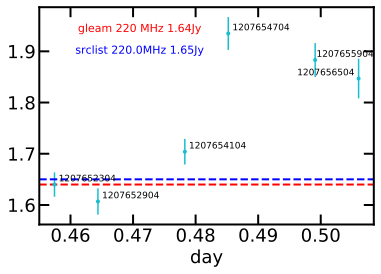

In [352]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
plot_df=df_157_src1000_large1
name_=skymodeldata_1000_infield_1Jy['Name'][2]
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        


for j in range(len(plot_df)):
    color=color_dict_band[plot_df['freq'][j]]

    ax.errorbar(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],yerr=plot_df['flux_err'][j],
                                marker='.',color=color,
                                label=plot_df['freq'][j])
    
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_220'],color='r',ls='--',lw=2)
    ax.text(0.3, 0.9, 'gleam 220 MHz %.2fJy'%gleam_PKS0736['int_flux_220'][0],
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(0.3, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]),
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')
        
        
texts = [ax.text(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],plot_df['obsid'][j],fontsize=9)
         for j in range(len(plot_df))]

adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text     
        
set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2    
plt.xlabel('day')
plt.savefig('lc_157_src1000_large1.png')

## selfcal_1

In [342]:
no_table_obsids_157_selfcal_1,no_select_obsids_157_selfcal_1, with_noise_obsids_157_selfcal_1,df_157_selfcal_1=return_table_of_onesource(path_157,ra=114.825,dec=1.618,prefix='selfcal_1')

In [343]:
df_157_selfcal_1

,obsid,mjd,freq,flux,flux_err,peak_flux,err_peak_flux,dec,ra
0,1207652304,58221.457442,215,1.598792552947998,0.02325543202459812,1.5661410093307495,0.019983865320682526,1.618,114.825
1,1207652904,58221.464387,215,1.6338846683502197,0.025649188086390495,1.6231801509857178,0.022400621324777603,1.618,114.825
2,1207654104,58221.478275,215,1.762086033821106,0.02601560205221176,1.7709530591964722,0.02308046445250511,1.618,114.825
3,1207654704,58221.485220,215,1.9699621200561523,0.0324874147772789,1.8022475242614746,0.026230670511722565,1.618,114.825
4,1207655904,58221.499109,215,1.89771568775177,0.03372892364859581,1.9002436399459839,0.030023999512195587,1.618,114.825
5,1207656504,58221.506053,215,1.8483794927597046,0.040640830993652344,1.872036337852478,0.03670463338494301,1.618,114.825


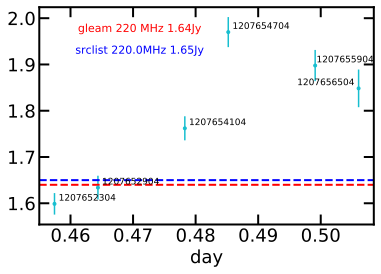

In [345]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
plot_df=df_157_selfcal_1
name_=skymodeldata_1000_infield_1Jy['Name'][2]
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        


for j in range(len(plot_df)):
    color=color_dict_band[plot_df['freq'][j]]

    ax.errorbar(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],yerr=plot_df['flux_err'][j],
                                marker='.',color=color,
                                label=plot_df['freq'][j])
    
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_220'],color='r',ls='--',lw=2)
    ax.text(0.3, 0.9, 'gleam 220 MHz %.2fJy'%gleam_PKS0736['int_flux_220'][0],
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(0.3, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]),
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')
        
        
texts = [ax.text(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],plot_df['obsid'][j],fontsize=9)
         for j in range(len(plot_df))]

adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text     
        
set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2    
plt.xlabel('day')
plt.savefig('lc_157_selfcal_1.png')

## src1000_large3_path

In [356]:
no_table_obsids_157_src1000_large3,no_select_obsids_157_src1000_large3, with_noise_obsids_157_src1000_large3,df_157_src1000_large3=return_table_of_onesource(path_src1000_large3,ra=114.825,dec=1.618,prefix='src1000_large3')

In [357]:
df_157_src1000_large3

,obsid,mjd,freq,flux,flux_err,peak_flux,err_peak_flux,dec,ra
0,1207652304,58221.457442,215,1.6255640983581543,0.02576206997036934,1.7353618144989014,0.024182593449950218,1.618,114.825
1,1207652904,58221.464387,215,1.6302268505096436,0.02769155241549015,1.686225175857544,0.02519318088889122,1.618,114.825
2,1207654104,58221.478275,215,1.6757792234420776,0.02667837031185627,1.838336706161499,0.02588917315006256,1.618,114.825
3,1207654704,58221.485220,215,1.8843183517456055,0.033864498138427734,1.8665529489517212,0.029630271717905998,1.618,114.825
4,1207655904,58221.499109,215,1.8591930866241455,0.035152845084667206,1.9596145153045654,0.03295387327671051,1.618,114.825
5,1207656504,58221.506053,215,1.7922937870025635,0.040329642593860626,1.9095460176467896,0.0383358933031559,1.618,114.825
6,1207738464,58222.454664,215,1.6763399839401245,0.02617444284260273,1.7938783168792725,0.024655809625983238,1.618,114.825
7,1207739064,58222.461609,215,1.6334664821624756,0.026935702189803123,1.6892098188400269,0.024500185623764992,1.618,114.825
8,1207740264,58222.475498,215,1.6598337888717651,0.02692534402012825,1.8230050802230835,0.026157770305871964,1.618,114.825
9,1207740864,58222.482442,215,1.8860362768173218,0.03296244144439697,1.8736788034439087,0.028927966952323914,1.618,114.825


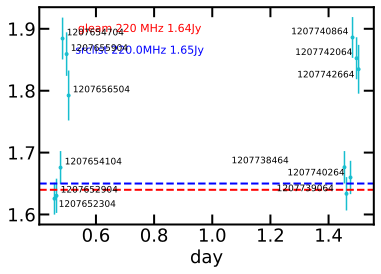

In [358]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
plot_df=df_157_src1000_large3
name_=skymodeldata_1000_infield_1Jy['Name'][2]
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        


for j in range(len(plot_df)):
    color=color_dict_band[plot_df['freq'][j]]

    ax.errorbar(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],yerr=plot_df['flux_err'][j],
                                marker='.',color=color,
                                label=plot_df['freq'][j])
    
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_220'],color='r',ls='--',lw=2)
    ax.text(0.3, 0.9, 'gleam 220 MHz %.2fJy'%gleam_PKS0736['int_flux_220'][0],
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(0.3, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]),
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')
        
        
texts = [ax.text(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],plot_df['obsid'][j],fontsize=9)
         for j in range(len(plot_df))]

adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text     
        
set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2    
plt.xlabel('day')
plt.savefig('lc_157_src1000_large3.png')

## src1000_large6_path

In [290]:
no_table_obsids_157_src1000_large6,no_select_obsids_157_src1000_large6, with_noise_obsids_157_src1000_large6,df_157_src1000_large6=return_table_of_onesource(src1000_large6_path,ra=114.825,dec=1.618,prefix='src1000_large6')

In [291]:
df_157_src1000_large6

,obsid,mjd,freq,flux,flux_err,peak_flux,err_peak_flux,dec,ra
0,1207652304,58221.457442,215,1.5964925289154053,0.039912149310112,1.704364538192749,0.037468720227479935,1.618,114.825
1,1207652904,58221.464387,215,1.5812193155288696,0.03988509997725487,1.6672077178955078,0.03701571375131607,1.618,114.825
2,1207654104,58221.478275,215,1.6555092334747314,0.04020782187581062,1.810843586921692,0.03889699652791023,1.618,114.825
3,1207654704,58221.485220,215,1.9505507946014404,0.04882083088159561,1.885899305343628,0.04165959358215332,1.618,114.825
4,1207655904,58221.499109,215,1.9141874313354492,0.051792871206998825,1.9737802743911743,0.04745803773403168,1.618,114.825
5,1207656504,58221.506053,215,1.8225926160812378,0.05963478609919548,1.935072660446167,0.056482814252376556,1.618,114.825


/share/home/blv/anaconda3/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


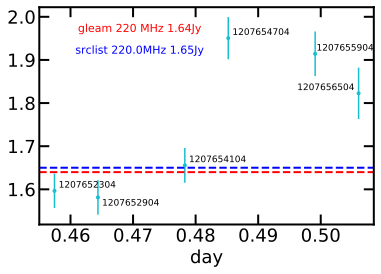

In [292]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
plot_df=df_157_src1000_large6
name_=skymodeldata_1000_infield_1Jy['Name'][2]
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        


for j in range(len(plot_df)):
    color=color_dict_band[plot_df['freq'][j]]

    ax.errorbar(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],yerr=plot_df['flux_err'][j],
                                marker='.',color=color,
                                label=plot_df['freq'][j])
    
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_220'],color='r',ls='--',lw=2)
    ax.text(0.3, 0.9, 'gleam 220 MHz %.2fJy'%gleam_PKS0736['int_flux_220'][0],
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(0.3, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]),
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')
        
        
texts = [ax.text(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],plot_df['obsid'][j],fontsize=9)
         for j in range(len(plot_df))]

adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text     
        
set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2    
plt.xlabel('day')
plt.savefig('lc_157_src1000_large6.png')

## nan_157_src1000_large1

In [78]:
no_table_obsids_nan_157_src1000_large1,no_select_obsids_nan_157_src1000_large1, with_noise_obsids_nan_157_src1000_large1,df_nan_157_src1000_large1=return_table_of_onesource(nan_path_157,ra=114.825,dec=1.618,prefix='src1000_large1')

In [79]:
df_nan_157_src1000_large1

,obsid,mjd,freq,flux,flux_err,peak_flux,err_peak_flux,dec,ra
0,1207742064,58222.496331,215,1.7898035049438477,0.033664122223854065,1.8785006999969482,0.031462978571653366,1.618,114.825
1,1208086720,58226.485405,215,1.9046558141708374,0.03770512342453003,1.9978225231170654,0.03515838831663132,1.618,114.825
2,1208345216,58229.477257,215,1.871321201324463,0.03885187581181526,1.9211114645004272,0.03551426902413368,1.618,114.825
3,1208431376,58230.474479,215,1.863477110862732,0.03727993741631508,1.9566174745559692,0.03487863764166832,1.618,114.825
4,1208515744,58231.450961,215,1.7220544815063477,0.02915232442319393,1.8270533084869385,0.027562204748392105,1.618,114.825
5,1208776032,58234.463553,215,1.8641208410263062,0.03469809144735336,1.9707289934158325,0.03272286430001259,1.618,114.825
6,1208777832,58234.484387,215,2.595426559448242,0.22039702534675598,2.314584970474243,0.17498482763767242,1.618,114.825
7,1209120696,58238.452720,215,1.9214825630187988,0.0348803773522377,1.98287034034729,0.03208146616816521,1.618,114.825


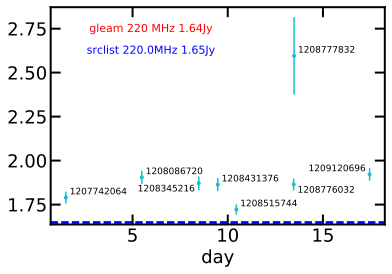

In [122]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
plot_df=df_nan_157_src1000_large1
name_=skymodeldata_1000_infield_1Jy['Name'][2]
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        


for j in range(len(plot_df)):
    color=color_dict_band[plot_df['freq'][j]]

    ax.errorbar(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],yerr=plot_df['flux_err'][j],
                                marker='.',color=color,
                                label=plot_df['freq'][j])
    
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_220'],color='r',ls='--',lw=2)
    ax.text(0.3, 0.9, 'gleam 220 MHz %.2fJy'%gleam_PKS0736['int_flux_220'][0],
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(0.3, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]),
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')
        
        
texts = [ax.text(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],plot_df['obsid'][j],fontsize=9)
         for j in range(len(plot_df))]

adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text     
        
set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2    
plt.xlabel('day')
plt.savefig('lc_nan_157_src1000_large1.png')

## nan_157_src1000_large3

In [107]:
no_table_obsids_nan_157_src1000_large3,no_select_obsids_nan_157_src1000_large3, with_noise_obsids_nan_157_src1000_large3,df_nan_157_src1000_large3=return_table_of_onesource(nan_path_157,ra=114.825,dec=1.618,prefix='src1000_large3')

In [108]:
df_nan_157_src1000_large3

,obsid,mjd,freq,flux,flux_err,peak_flux,err_peak_flux,dec,ra
0,1207742064,58222.496331,215,1.8353033065795898,0.03467795252799988,1.9527877569198608,0.03282675892114639,1.618,114.825
1,1208086720,58226.485405,215,1.8551079034805298,0.03783578425645828,1.957698941230774,0.035449933260679245,1.618,114.825
2,1208431376,58230.474479,215,1.7989192008972168,0.03553507849574089,1.9092178344726562,0.033575933426618576,1.618,114.825
3,1208515744,58231.450961,215,1.8057610988616943,0.03178991749882698,1.9273430109024048,0.03016129694879055,1.618,114.825
4,1208776032,58234.463553,215,1.9151430130004883,0.04737277701497078,2.0643489360809326,0.04551555961370468,1.618,114.825
5,1208777832,58234.484387,215,2.7596559524536133,0.5263280868530273,2.943171262741089,0.4875451326370239,1.618,114.825
6,1209120696,58238.452720,215,1.898271083831787,0.0346510112285614,1.9622876644134521,0.03188129886984825,1.618,114.825


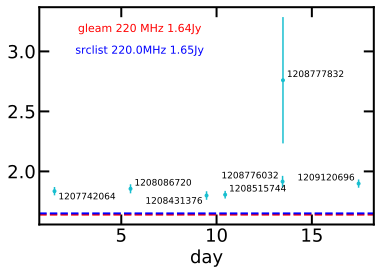

In [123]:
from adjustText import adjust_text

fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  

intmjd0=58221
plot_df=df_nan_157_src1000_large3
name_=skymodeldata_1000_infield_1Jy['Name'][2]
calibration_freq,calibration_flux=calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['freq'], calibration_1000_data_220[calibration_1000_data_220['Name']==name_]['flux']                        


for j in range(len(plot_df)):
    color=color_dict_band[plot_df['freq'][j]]

    ax.errorbar(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],yerr=plot_df['flux_err'][j],
                                marker='.',color=color,
                                label=plot_df['freq'][j])
    
if calibration_freq:
    ax.axhline(gleam_PKS0736['int_flux_220'],color='r',ls='--',lw=2)
    ax.text(0.3, 0.9, 'gleam 220 MHz %.2fJy'%gleam_PKS0736['int_flux_220'][0],
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='r')

    ax.axhline(calibration_flux,color='b',ls='--',lw=2)
    ax.text(0.3, 0.8, 'srclist %sMHz %sJy'%(calibration_freq[0],calibration_flux[0]),
            horizontalalignment = 'center', verticalalignment = 'center', 
            transform = ax.transAxes, fontsize = 11,color='b')
        
        
texts = [ax.text(plot_df['mjd'][j]-intmjd0,plot_df['flux'][j],plot_df['obsid'][j],fontsize=9)
         for j in range(len(plot_df))]

adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text     
        
set_ax_tick(ax)
plt.rcParams['font.size'] = 18
plt.rcParams['axes.linewidth'] = 2    
plt.xlabel('day')
plt.savefig('lc_nan_157_src1000_large3.png')

In [124]:
pwd

'/share/home/blv/mwa_code_py/ipynb'

## lightcurve

In [125]:
path_lc

'/share/home/blv/MWAdata/qguo_data/lightcurve/'

### dec plot_source_lightcurve

In [271]:
def plot_source_lightcurve(ax,path,index,skymodeldata,calibration_data,intmjd0=58221,prefix='briggsplus1',savefig=False): 
    ra_=skymodeldata['ra'][index]
    dec_=skymodeldata['dec'][index]
    name_=skymodeldata['Name'][index]
    peaks_=skymodeldata['peak_flux'][index]
      
    lc_path_img='%s/lc_%d_%s_%.3f_%.3f.png'%(path_lc,index,name_,ra_,dec_)               
    no_table_obsids,no_select_obsids, with_noise_obsids,df_= \
            return_table_of_onesource(path,ra_,dec_,prefix)
        #ax.errorbar(mjdtime_frac*24,flux,yerr=flux_err,marker='.',color=color,label=str(freq))    
        
    if len(df_)>2:
        for j in range(len(df_)):
            color=color_dict_band[df_['freq'][j]]
            ax.errorbar((df_['mjd'][j]-intmjd0)*24,df_['flux'][j],yerr=df_['flux_err'][j],
                        marker='.',color=color,
                        label=df_['freq'][j])

        calibration_freq,calibration_flux=calibration_data[calibration_data['Name']==name_]['freq'], calibration_data[calibration_data['Name']==name_]['flux']                                       
        if calibration_freq:
            ax.axhline(calibration_flux,color='b',ls='--',lw=2)  
            ax.text(1.2, 0.5, 'SM %s MHz %sJy'%(calibration_freq[0],calibration_flux[0]), 
                    horizontalalignment = 'center', verticalalignment = 'center', 
                    transform = ax.transAxes, fontsize = 11,color='b')

            gleam_calibration=gleamdata[gleamdata['Name']=='GLEAM '+name_]          
            ax.axhline(gleam_calibration['int_flux_220'],color='r',ls='--',lw=2)
            ax.text(1.2, 0.6, 'gleam 220 MHz %.2fJy'%gleam_calibration['int_flux_220'][0],
                             horizontalalignment = 'center', verticalalignment = 'center', 
                              transform = ax.transAxes, fontsize = 11,color='r')
            texts = [ax.text((df_['mjd'][j]-intmjd0)*24,df_['flux'][j],df_['obsid'][j],fontsize=9) for j in range(len(df_))]

            adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text                
            
    for i in with_noise_obsids:
        print(name_,'noise_obsid',i)

    handles, labels = ax.get_legend_handles_labels()
# remove the errorbars
    hdl = [h[0] for h in handles]
# use them in the legend
    by_label = OrderedDict(zip(labels, hdl)) 
    ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.0, 1.0),
         loc=2, numpoints=1,ncol=1, fontsize=11.)

    plt.title(name_)
    ax.set_xlabel('MJD-%s (hours)'%intmjd0)
    ax.set_ylabel('Jy') 
    plt.rcParams['font.size'] = 18
    plt.rcParams['axes.linewidth'] = 2 
    
    if savefig:
    #if not os.path.exists(lc_path_img): 
        fig.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')


In [130]:
print(skymodeldata_1000_infield_1Jy[2]['Name'])

J073918+013708


### skymodeldata_1000_infield_1Jy

In [134]:
len(skymodeldata_1000_infield_1Jy)

12

### path_157src1000_large1

J073918+013708


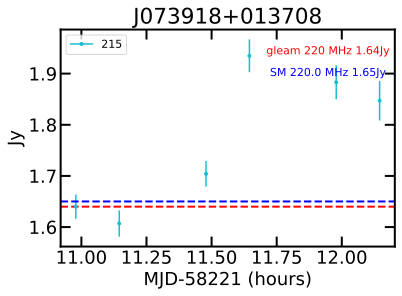

In [131]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=2
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

J073354+020223


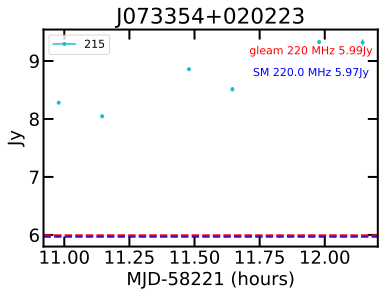

In [132]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=1
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

J073433+031515


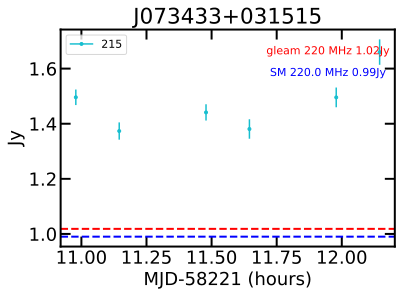

In [135]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=3
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

### briggsplus1

J073918+013708


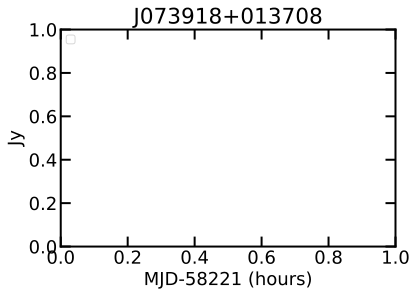

In [92]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=2
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,nan_path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='briggsplus1',)

### nan_path_157src1000_large1

J073918+013708


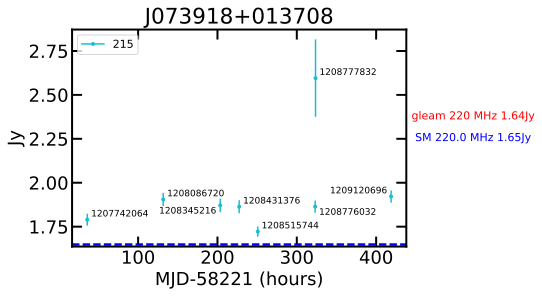

In [272]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=2
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,nan_path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

J073354+020223


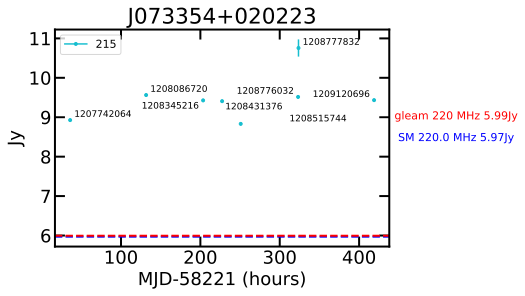

In [274]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=1
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,nan_path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

J073433+031515


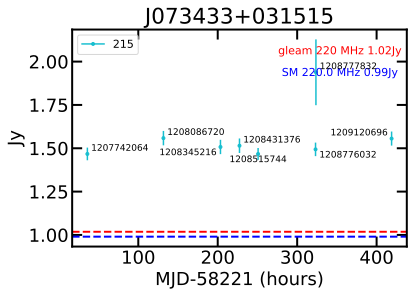

In [266]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=3
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,nan_path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

### nan_path_157src1000_large3

J073918+013708


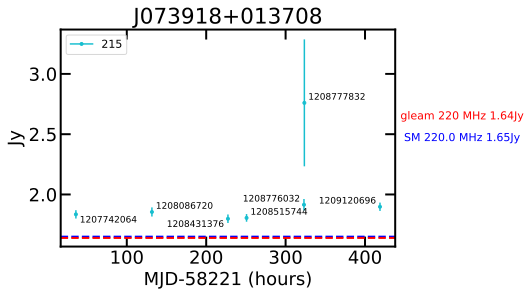

In [273]:
fig = plt.figure(figsize=(6,4))
ax = fig.add_subplot(111)  
set_ax_tick(ax)
plotindex=2
print(skymodeldata_1000_infield_1Jy[plotindex]['Name'])
plot_source_lightcurve(ax,nan_path_157,plotindex,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large3',)

## plot_sources_lightcurve

In [269]:
def plot_sources_lightcurve(path,skymodeldata,calibration_data,intmjd0=58221,prefix='briggsplus1',savefig=False):
 
    ras=skymodeldata['ra']
    decs=skymodeldata['dec']
    names=skymodeldata['Name']
    peaks=skymodeldata['peak_flux']
    
    for index,(ra_,dec_,name_) in enumerate(zip(ras,decs,names)):    

        lc_path_img='%s/lc_%d_%s_%.3f_%.3f.png'%(path_lc,index,name_,ra_,dec_)                         
        no_table_obsids,no_select_obsids, with_noise_obsids,df_= \
                return_table_of_onesource(path,ra_,dec_,prefix)
            
        #ax.errorbar(mjdtime_frac*24,flux,yerr=flux_err,marker='.',color=color,label=str(freq))
        fig = plt.figure(figsize=(6,4))
        ax = fig.add_subplot(111)   
        set_ax_tick(ax) 
        
        if len(df_)>2:
            ax.errorbar((df_['mjd']-intmjd0)*24,df_['flux'],yerr=df_['flux_err'],
                        ls='',
                        marker='.',color=colors_cm_10(9),label=name_)

            calibration_freq,calibration_flux=calibration_data[calibration_data['Name']==name_]['freq'], calibration_data[calibration_data['Name']==name_]['flux']                        
            if calibration_freq:
    
                ax.axhline(calibration_flux,color='b',ls='--',lw=2)  
                ax.text(1.0, 0.8, 'SM %s MHz %sJy'%(calibration_freq[0],calibration_flux[0]), 
                        horizontalalignment = 'center', verticalalignment = 'center', 
                        transform = ax.transAxes, fontsize = 11,color='b')

                gleam_calibration=gleamdata[gleamdata['Name']=='GLEAM '+name_]          
                ax.axhline(gleam_calibration['int_flux_220'],color='r',ls='--',lw=2)
                ax.text(1.0, 0.9, 'gleam 220 MHz %.2fJy'%gleam_calibration['int_flux_220'][0],
                                 horizontalalignment = 'center', verticalalignment = 'center', 
                                  transform = ax.transAxes, fontsize = 11,color='r')
            texts = [ax.text((df_['mjd'][j]-intmjd0)*24,df_['flux'][j],df_['obsid'][j],fontsize=9) for j in range(len(df_))]

            adjust_text(texts,ax=ax,#arrowprops=dict(arrowstyle='->', color='red',lw=0.5),
            expand_text=(1.15,1.3),
            expand_points=(1.15,1.3),
            expand_objects=(1.15, 1.3),
            expand_align=(1.15, 1.3),
            autoalign='xy',
           #only_move={'points':'x', 'text':'x'}
           ) #使用adjust_text     
   

        handles, labels = ax.get_legend_handles_labels()

        hdl = [h[0] for h in handles]
        by_label = OrderedDict(zip(labels, hdl)) 
        ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(0.0, 1.0),
             loc=2, numpoints=1,ncol=1, fontsize=11.)
        
        plt.title(name_)
        ax.set_xlabel('MJD-%s (hours)'%intmjd0)
        ax.set_ylabel('Jy') 
        plt.rcParams['font.size'] = 18
        plt.rcParams['axes.linewidth'] = 2 
        
        if savefig: 
            fig.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')

In [143]:
calibration_1000_data_220[calibration_1000_data_220['Name']==skymodeldata_1000_infield_1Jy['Name'][2]]    

FITS_rec([('J073918+013708', 114.825, 1.61805556, '07:39:18', '+01:37:05', 0., 0., 0., 220., 1.65)],
         dtype=(numpy.record, [('Name', 'S14'), ('ra', '>f8'), ('dec', '>f8'), ('ra_str', 'S10'), ('dec_str', 'S9'), ('a', '>f8'), ('b', '>f8'), ('pa', '>f8'), ('freq', '>f8'), ('flux', '>f8')]))

### skymodeldata_1000_infield_1Jy

In [144]:
print(len(skymodeldata_1000_infield_1Jy))

12


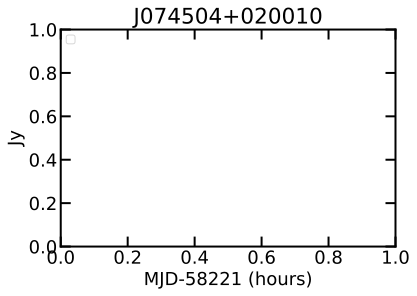

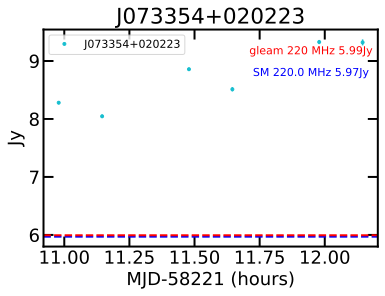

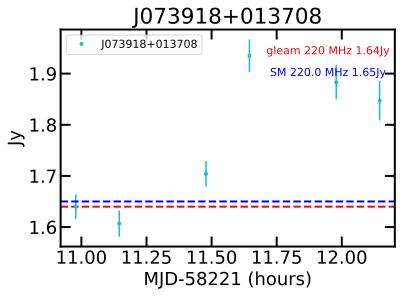

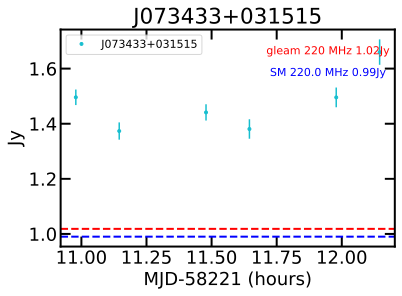

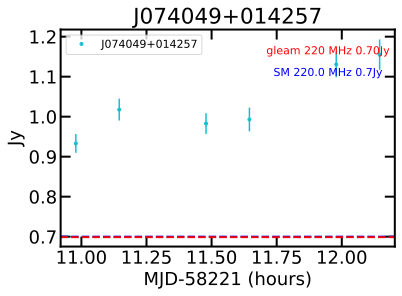

...

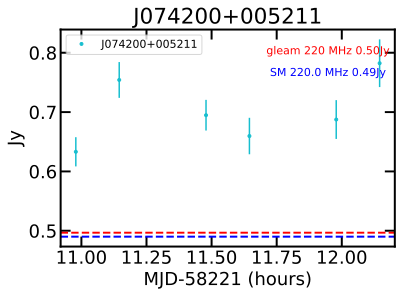

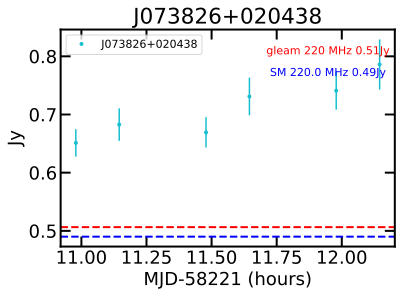

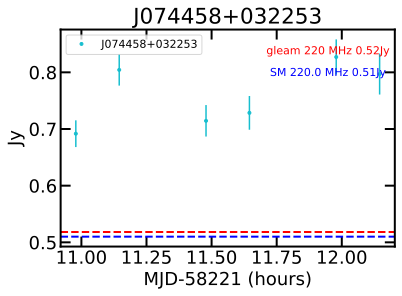

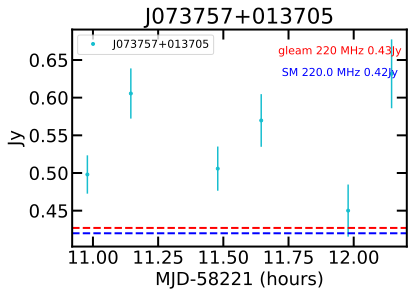

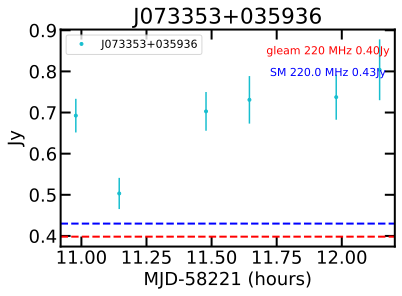

In [146]:
plot_sources_lightcurve(path_157,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',savefig=True)

### src1000_large3_path

/share/home/blv/anaconda3/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


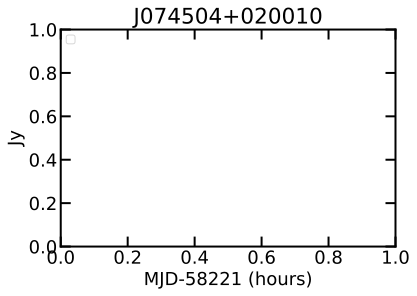

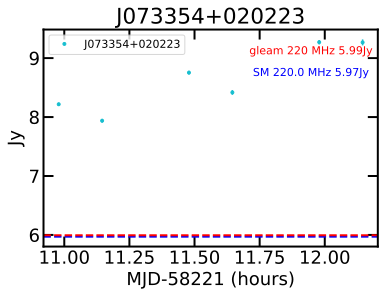

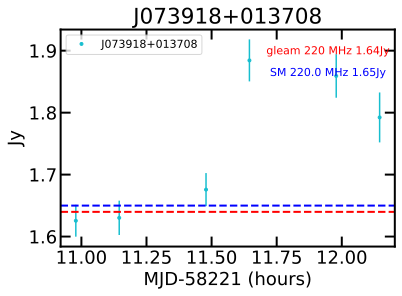

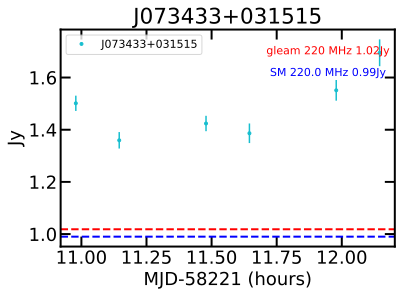

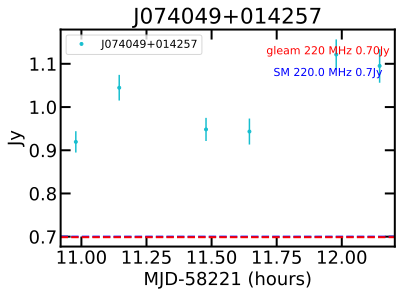

...

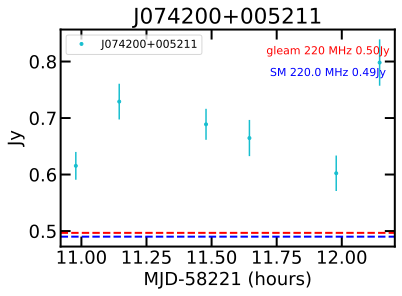

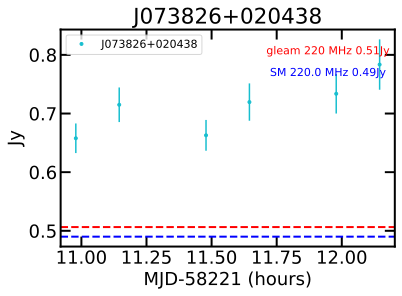

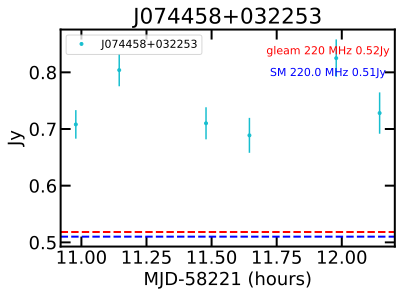

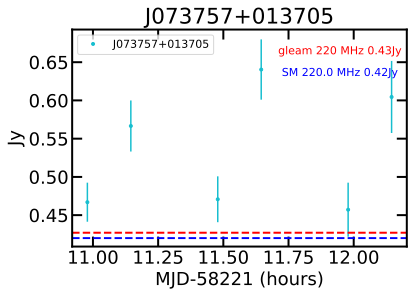

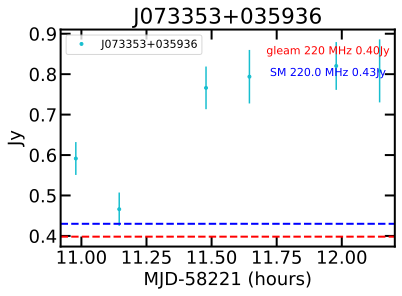

In [150]:
plot_sources_lightcurve(src1000_large3_path,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large3',savefig=True)

### skymodeldata_100_10Jy

In [147]:
print(len(skymodeldata_100_10Jy))

19


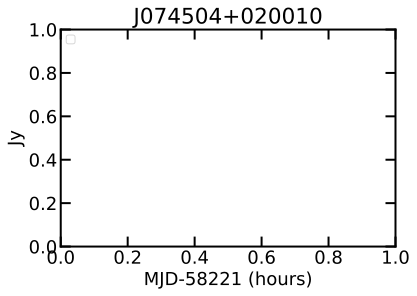

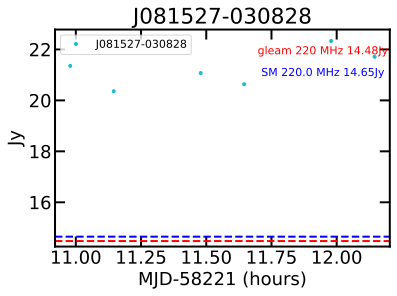

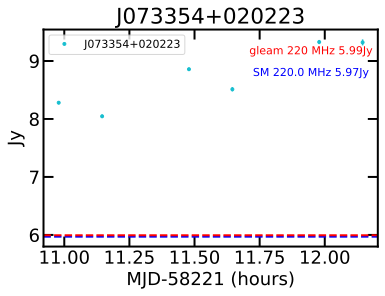

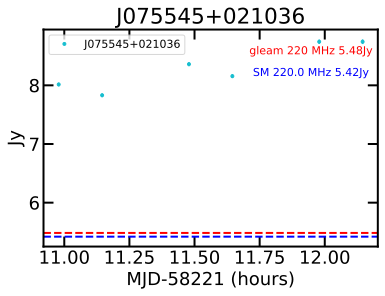

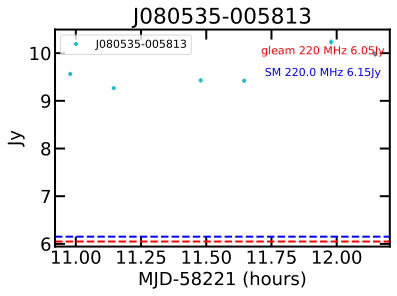

...

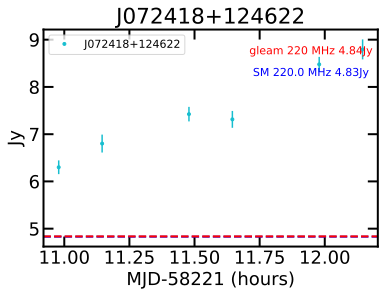

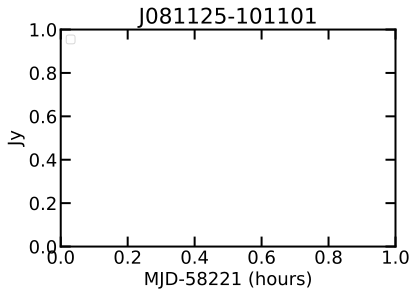

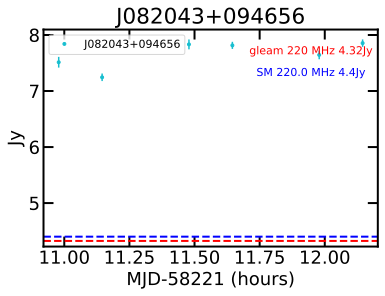

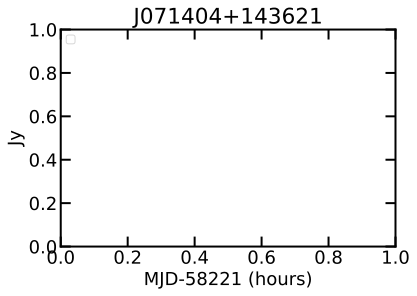

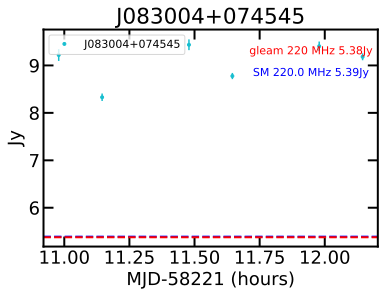

In [148]:
plot_sources_lightcurve(path_157,skymodeldata_100_10Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',savefig=True)

## plot_ratio_lightcurve

In [154]:
def plot_ratio_lightcurve(path,img,skymodeldata,calibration_data,intmjd0=58221,prefix='briggsplus1',):
  
    ras=skymodeldata['ra']
    decs=skymodeldata['dec']
    names=skymodeldata['Name']
    peaks=skymodeldata['peak_flux']
    
    fig = plt.figure(figsize=(6,8))
    ax = fig.add_subplot(111)   
    set_ax_tick(ax) 
    
    lc_path_img='%s/lc_ratio_%s.png'%(path_lc,img)   
    for index,(ra_,dec_,name_) in enumerate(zip(ras,decs,names)):     
#print(ra,dec,name_source)      
        no_table_obsids,no_select_obsids, with_noise_obsids,df_= \
            return_table_of_onesource(path,ra_,dec_,prefix)
        calibration_freq,calibration_flux=calibration_data[calibration_data['Name']==name_]['freq'], calibration_data[calibration_data['Name']==name_]['flux']            
        if calibration_freq and len(df_)>2:
            #ax.axhline(calibration_flux,color='b',ls='--',lw=2)  
            ax.errorbar((df_['mjd']-intmjd0)*24,calibration_flux[0]/df_['flux'],
                        #yerr=df_['flux_err'],
                        ls='',
                        marker='.',
                        #color=colors_cm_10(9),
                        label=name_)

        for i in with_noise_obsids:
            print(name_,'noise_obsid',i)

    handles, labels = ax.get_legend_handles_labels()
# remove the errorbars
    hdl = [h[0] for h in handles]
# use them in the legend
    by_label = OrderedDict(zip(labels, hdl)) 
    ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1.0, 1.0),
             loc=2, numpoints=1,ncol=1, fontsize=11.)

    #plt.title(name_)
    ax.set_xlabel('MJD-%s (hours)'%intmjd0)
    ax.set_ylabel('flux ratio of cal to obs') 
    plt.rcParams['font.size'] = 18
    plt.rcParams['axes.linewidth'] = 2 
       
    fig.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')

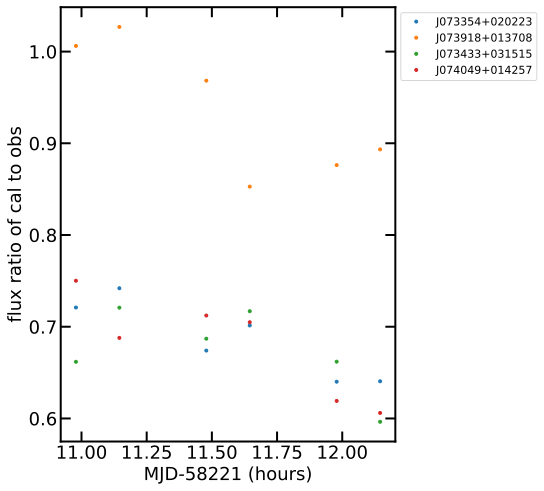

In [155]:
plot_ratio_lightcurve(path_157,'skymodeldata_1000_infield_1Jy',skymodeldata_1000_infield_1Jy[0:5],calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

## def plot_ratio_calibration_data_one_obsid

In [ ]:
table_briggsplus1=read_tables(path_157,obsids_157[6],prefix='briggsplus1')

In [ ]:
table_briggsplus1.colnames

In [ ]:
ra_=114.825
dec_=1.618
table_source_briggsplus1=table_briggsplus1[abs(table_briggsplus1['ra']-ra_)<0.01]
table_source_briggsplus1=table_source_briggsplus1[abs(table_source_briggsplus1['dec']-dec_)<0.01]

In [ ]:
table_source_briggsplus1['int_flux'][0]

In [191]:
table_src1000_large1=read_tables(path_157,obsids_157[0],prefix='src1000_large1')

In [192]:
table_src1000_large1.colnames

['island',
 'source',
 'background',
 'local_rms',
 'ra_str',
 'dec_str',
 'ra',
 'err_ra',
 'dec',
 'err_dec',
 'peak_flux',
 'err_peak_flux',
 'int_flux',
 'err_int_flux',
 'a',
 'err_a',
 'b',
 'err_b',
 'pa',
 'err_pa',
 'flags',
 'residual_mean',
 'residual_std',
 'uuid',
 'psf_a',
 'psf_b',
 'psf_pa']

In [193]:
calibration_1000_data_220.columns

ColDefs(
    name = 'Name'; format = '14A'
    name = 'ra'; format = 'D'
    name = 'dec'; format = 'D'
    name = 'ra_str'; format = '10A'
    name = 'dec_str'; format = '9A'
    name = 'a'; format = 'D'
    name = 'b'; format = 'D'
    name = 'pa'; format = 'D'
    name = 'freq'; format = 'D'
    name = 'flux'; format = 'D'
)

## def plot_ratio_calibration_data_one_obsid_ra

In [200]:
def plot_ratio_calibration_data_one_obsid_ra(path,obsid,img,skymodeldata,calibration_data,intmjd0=58221,prefix='briggsplus1',gleamlabel=False):
    
    if gleamlabel==True:
        ralabel='RAJ2000'
        declabel='DEJ2000'
        calflux_label='int_flux_220'
        lc_path_img='%s/lc_ratio_ra_gleam_%s.png'%(path_lc_ratio,img)
        
    else:
        ralabel='ra'
        declabel='dec'
        calflux_label='flux'
        lc_path_img='%s/lc_ratio_ra_%s.png'%(path_lc_ratio,img)
    
    tableflux_label='int_flux'
    
    
    table=read_tables(path,obsid,prefix)
    ras=skymodeldata[ralabel]
    decs=skymodeldata[declabel]
    names=skymodeldata['Name']
    #peaks=skymodeldata[fluxlabel] 
    
    flux_ratio=[]
    
    
    for index,(ra_,dec_,name_) in enumerate(zip(ras,decs,names)):     

        table_source=table[abs(table['ra']-ra_)<0.01]
        table_source=table_source[abs(table_source['dec']-dec_)<0.01]

        if gleamlabel==True:   
            #gleam_calibration=gleamdata[gleamdata['Name']=='GLEAM '+name_]  
            gleam_calibration=gleamdata[gleamdata['Name']==name_]  
            calibration_flux=gleam_calibration[calflux_label]      

        else:    
            calibration_flux=calibration_data[calibration_data['Name']==name_]['flux'][0]      

        if len(table_source)>0:

            table_source_flux=table_source[tableflux_label][0]    

            plt.plot(ra_,table_source_flux/calibration_flux,ls='',marker='.')
            flux_ratio.append(table_source_flux/calibration_flux)

    return flux_ratio,lc_path_img    

/share/home/blv/anaconda3/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_ra_skymodeldata_1000_1207652304.png


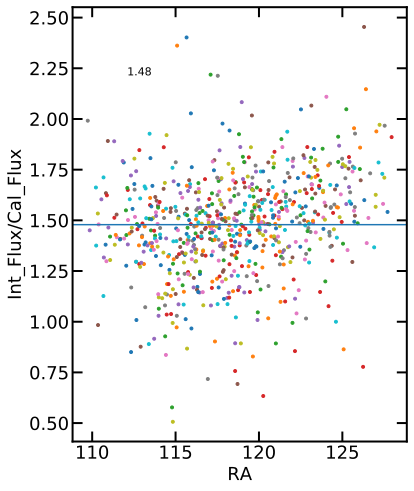

In [179]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img =plot_ratio_calibration_data_one_obsid_ra(path_157,obsids_157[0],'skymodeldata_1000'+'_'+obsids_157[0],skymodeldata_1000,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)
print(lc_path_img)
ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('RA')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')        

/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_ra_skymodeldata_100_1207652304.png


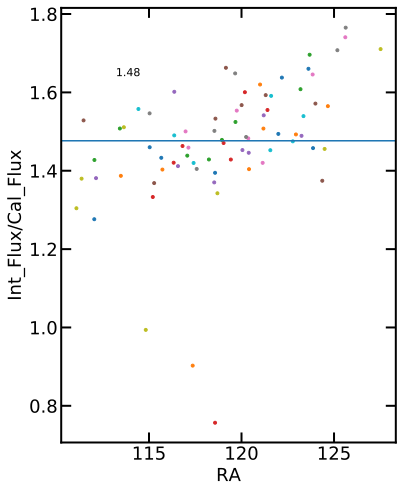

In [180]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img =plot_ratio_calibration_data_one_obsid_ra(path_157,obsids_157[0],'skymodeldata_100'+'_'+obsids_157[0],skymodeldata_100,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)
print(lc_path_img)
ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('RA')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')        

/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_ra_skymodeldata_1000_1207654704.png


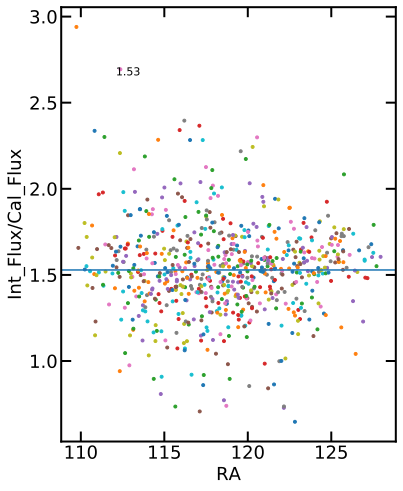

In [182]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img =plot_ratio_calibration_data_one_obsid_ra(path_157,obsids_157[3],'skymodeldata_1000'+'_'+obsids_157[3],skymodeldata_1000,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)
print(lc_path_img)
ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('RA')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')        

/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_ra_skymodeldata_100_1207654704.png


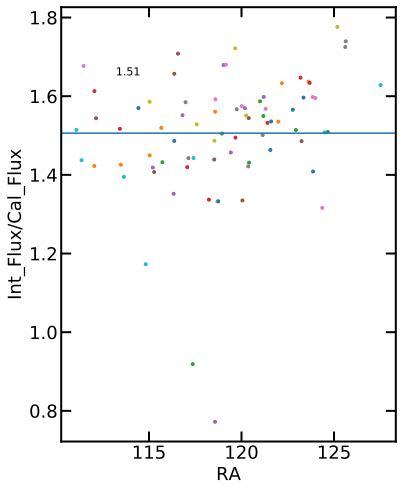

In [181]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img =plot_ratio_calibration_data_one_obsid_ra(path_157,obsids_157[3],'skymodeldata_100'+'_'+obsids_157[3],skymodeldata_100,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)
print(lc_path_img)
ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('RA')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')        

## def plot_ratio_calibration_data_one_obsid_dec

In [206]:
def plot_ratio_calibration_data_one_obsid_dec(path,obsid,img,skymodeldata,calibration_data,intmjd0=58221,prefix='briggsplus1',gleamlabel=False):
    
    if gleamlabel==True:
        ralabel='RAJ2000'
        declabel='DEJ2000'
        calflux_label='int_flux_220'
        lc_path_img='%s/lc_ratio_dec_gleam_%s.png'%(path_lc_ratio,img)
        
    else:
        ralabel='ra'
        declabel='dec'
        calflux_label='flux'
        lc_path_img='%s/lc_ratio_dec_%s.png'%(path_lc_ratio,img)
    
    tableflux_label='int_flux'
    
    
    table=read_tables(path,obsid,prefix)
    ras=skymodeldata[ralabel]
    decs=skymodeldata[declabel]
    names=skymodeldata['Name']
    #peaks=skymodeldata[fluxlabel] 
    
    flux_ratio=[]
  
    for index,(ra_,dec_,name_) in enumerate(zip(ras,decs,names)):     

        table_source=table[abs(table['ra']-ra_)<0.01]
        table_source=table_source[abs(table_source['dec']-dec_)<0.01]

        if gleamlabel==True:   
            #gleam_calibration=gleamdata[gleamdata['Name']=='GLEAM '+name_]  
            gleam_calibration=gleamdata[gleamdata['Name']==name_]  
            calibration_flux=gleam_calibration[calflux_label]      

        else:    
            calibration_flux=calibration_data[calibration_data['Name']==name_]['flux'][0]      

        if len(table_source)>0:

            table_source_flux=table_source[tableflux_label][0]    

            plt.plot(dec_,table_source_flux/calibration_flux,ls='',marker='.')
            flux_ratio.append(table_source_flux/calibration_flux)

    return flux_ratio,lc_path_img    

/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_dec_skymodeldata_1000_1207652304.png


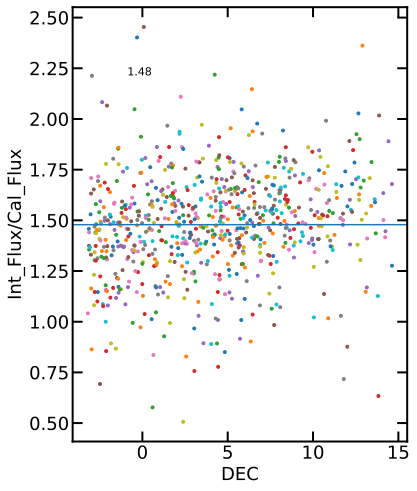

In [185]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img =plot_ratio_calibration_data_one_obsid_dec(path_157,obsids_157[0],'skymodeldata_1000'+'_'+obsids_157[0],skymodeldata_1000,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)
print(lc_path_img)
ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('DEC')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')        

/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_dec_skymodeldata_100_1207652304.png


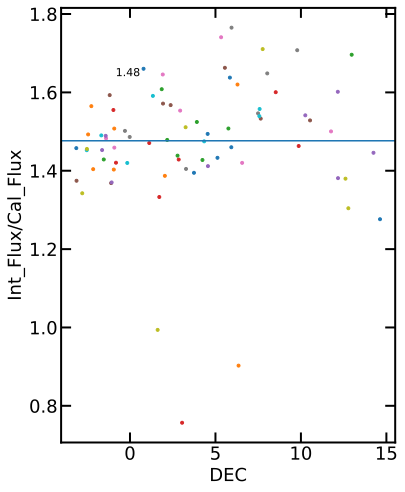

In [186]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img =plot_ratio_calibration_data_one_obsid_dec(path_157,obsids_157[0],'skymodeldata_100'+'_'+obsids_157[0],skymodeldata_100,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)
print(lc_path_img)
ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('DEC')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')        

## plot_ratio_calibration_data_one_obsid_ra_gleam

/share/home/blv/anaconda3/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_ra_gleam_skymodeldata_100_1207654704.png
197 86


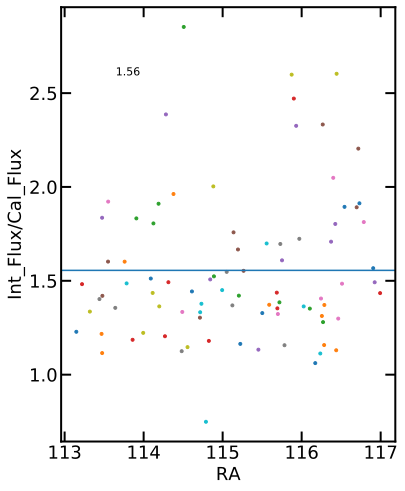

In [208]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img=plot_ratio_calibration_data_one_obsid_ra(path_157,obsids_157[3],'skymodeldata_100'+'_'+obsids_157[3],gleam_select_infield,gleamdata,intmjd0=58221,prefix='src1000_large1',gleamlabel=True)
print(lc_path_img)
print(len(gleam_select_infield),len(flux_ratios))

ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('RA')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')       

## plot_ratio_calibration_data_one_obsid_dec_gleam

/share/home/blv/MWAdata/qguo_data/lightcurve/lc_ratio/lc_ratio_dec_gleam_skymodeldata_100_1207654704.png
197 86


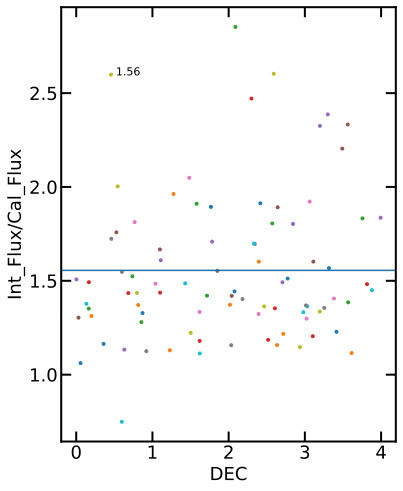

In [209]:
fig = plt.figure(figsize=(6,8))
ax = fig.add_subplot(111)   
set_ax_tick(ax) 

flux_ratios,lc_path_img=plot_ratio_calibration_data_one_obsid_dec(path_157,obsids_157[3],'skymodeldata_100'+'_'+obsids_157[3],gleam_select_infield,gleamdata,intmjd0=58221,prefix='src1000_large1',gleamlabel=True)
print(lc_path_img)
print(len(gleam_select_infield),len(flux_ratios))

ax.axhline(np.mean(flux_ratios))
ax.text(0.2, 0.85, '%.2f'%np.mean(flux_ratios), horizontalalignment = 'center', verticalalignment = 'center', transform = ax.transAxes, fontsize = 11)

plt.ylabel('Int_Flux/Cal_Flux')
plt.xlabel('DEC')
plt.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')       

## plot_calibrate_lightcurve

In [256]:
def plot_calibrate_lightcurve(path,target_index,skymodeldata,cal_index,skymodelCAldata,calibration_data,intmjd0=58221,prefix='briggsplus1',):
    obsids=get_obsids(path) 
    ra_target=skymodeldata['ra'][target_index]
    dec_target=skymodeldata['dec'][target_index]
    name_target=skymodeldata['Name'][target_index]
    peak_target=skymodeldata['peak_flux'][target_index]
    
    ra_cal=skymodelCAldata['ra'][cal_index]
    dec_cal=skymodelCAldata['dec'][cal_index]
    name_cal=skymodelCAldata['Name'][cal_index]
    peak_cal=skymodelCAldata['peak_flux'][cal_index]
    
    fig = plt.figure(figsize=(6,4))
    ax = fig.add_subplot(111)   
    set_ax_tick(ax) 
    
    lc_path_img='%s/lc_target_%d_%s_cal_%d_%s.png'%(path_calibrate_lightcurve,target_index,name_target,cal_index,name_cal)
             
    calibration_freq_cal,calibration_flux_cal=calibration_data[calibration_data['Name']==name_cal]['freq'],calibration_data[calibration_data['Name']==name_cal]['flux']            
    calibration_freq_target,calibration_flux_target=calibration_data[calibration_data['Name']==name_target]['freq'],calibration_data[calibration_data['Name']==name_target]['flux']            
    
    print('calibration_flux_cal',calibration_flux_cal[0])
    
    ax.axhline(calibration_flux_target,color='b',ls='--',lw=2)  
    ax.text(0.8, 0.8, 'SM %s MHz %sJy'%(calibration_freq_target[0],calibration_flux_target[0]), 
                horizontalalignment = 'center', verticalalignment = 'center', 
                transform = ax.transAxes, fontsize = 11,color='b')

    gleam_calibration=gleamdata[gleamdata['Name']=='GLEAM '+name_target]          
    ax.axhline(gleam_calibration['int_flux_220'],color='r',ls='--',lw=2)
    ax.text(0.8, 0.9, 'gleam 220 MHz %.2fJy'%gleam_calibration['int_flux_220'][0],
                         horizontalalignment = 'center', verticalalignment = 'center', 
                          transform = ax.transAxes, fontsize = 11,color='r')
    counts=0
    for index,obsid in enumerate(obsids):
        
        table_=read_tables(path,obsid,prefix)
        
        table_target=table_[abs(table_['ra']-ra_target)<0.01]
        table_target=table_target[abs(table_target['dec']-dec_target)<0.01] 
        
        table_cal=table_[abs(table_['ra']-ra_cal)<0.01]
        table_cal=table_cal[abs(table_cal['dec']-dec_cal)<0.01]
        
        if len(table_cal)>0 and len(table_target)>0:
            counts+=1
            
            obs_target_flux=table_target['int_flux'].quantity[0]              
            obs_target_flux_err=table_target['err_int_flux'].quantity[0]
        
 
            obs_cal_flux=table_cal['int_flux'].quantity[0]  
            obs_cal_flux_err=table_cal['err_int_flux'].quantity[0]  
              

            mjd=Time(obsid, format='gps').mjd
            
            calibrated_flux=obs_target_flux*calibration_flux_cal[0]/obs_cal_flux
            calibrated_flux_err=  ((obs_target_flux_err/obs_target_flux)**2+ (obs_cal_flux_err/obs_cal_flux)**2)**0.5*calibrated_flux
            
            ax.errorbar((mjd-intmjd0)*24,calibrated_flux,
                        yerr=calibrated_flux_err,
                    ls='',
                    marker='*',
                    color=colors_cm_10(1),
                    label='target:'+name_target+'\n'+'cal_with:'+name_cal)  
            
            ax.errorbar((mjd-intmjd0)*24,obs_target_flux,
                        yerr=obs_target_flux_err,
                    ls='',
                    marker='.',
                    color=colors_cm_10(0),
                    label='un_cal:'+name_target) 

    handles, labels = ax.get_legend_handles_labels()
    # remove the errorbars
    hdl = [h[0] for h in handles]
    # use them in the legend
    by_label = OrderedDict(zip(labels, hdl)) 
    ax.legend(by_label.values(), by_label.keys(), bbox_to_anchor=(1.0, 1.0),
             loc=2, numpoints=1,ncol=1, fontsize=11.)

    plt.title(name_target+'_%.3f_%.3f'%(ra_target,dec_target))
    ax.set_xlabel('MJD-%s (hours)'%intmjd0)
    ax.set_ylabel('Target lc with calibration ') 
    plt.rcParams['font.size'] = 18
    plt.rcParams['axes.linewidth'] = 2 
    if counts>0:
        fig.savefig(lc_path_img, dpi=400, transparent=False, bbox_inches='tight')

target J073918+013708 cal J073354+020223
calibration_flux_cal 5.97


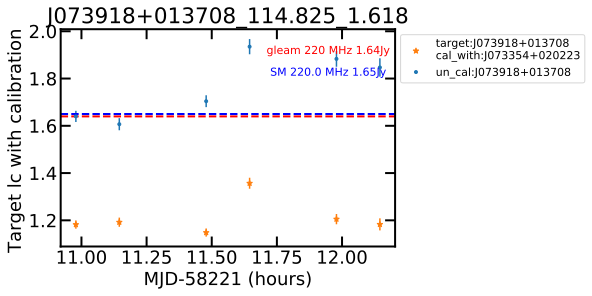

In [254]:
target_index,cal_index=2,1
print('target',skymodeldata_1000_infield_1Jy[target_index]['Name'],'cal',skymodeldata_1000_infield_1Jy[cal_index]['Name'],)
plot_calibrate_lightcurve(path_157,target_index,skymodeldata_1000_infield_1Jy,cal_index,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

target J073918+013708 cal J073433+031515
calibration_flux_cal 0.99


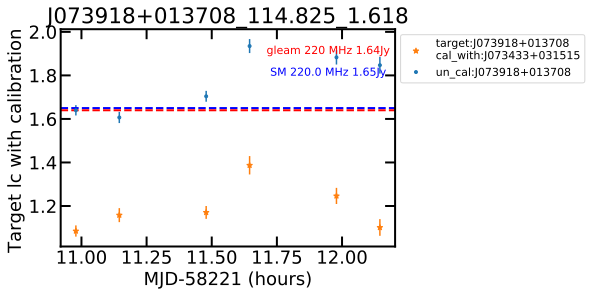

In [255]:
target_index,cal_index=2,3
print('target',skymodeldata_1000_infield_1Jy[target_index]['Name'],'cal',skymodeldata_1000_infield_1Jy[cal_index]['Name'],)
plot_calibrate_lightcurve(path_157,target_index,skymodeldata_1000_infield_1Jy,cal_index,skymodeldata_1000_infield_1Jy,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

In [250]:
len(skymodeldata_100_10Jy)

19

0 target J073918+013708 cal J074504+020010
calibration_flux_cal 8.49


/share/home/blv/anaconda3/lib/python3.7/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


1 target J073918+013708 cal J081527-030828
calibration_flux_cal 14.65
2 target J073918+013708 cal J073354+020223
calibration_flux_cal 5.97
3 target J073918+013708 cal J075545+021036
calibration_flux_cal 5.42
4 target J073918+013708 cal J080535-005813
calibration_flux_cal 6.15
5 target J073918+013708 cal J080853-102803
calibration_flux_cal 15.91
6 target J073918+013708 cal J080447+101520
calibration_flux_cal 10.26
7 target J073918+013708 cal J081522+015505
calibration_flux_cal 6.0
8 target J073918+013708 cal J082231+055626
calibration_flux_cal 10.05
9 target J073918+013708 cal J071302+114614
calibration_flux_cal 13.36
10 target J073918+013708 cal J081203-054921
calibration_flux_cal 5.94
11 target J073918+013708 cal J080133+141441
calibration_flux_cal 12.25
12 target J073918+013708 cal J080225-095823
calibration_flux_cal 5.1
13 target J073918+013708 cal J072810+143736
calibration_flux_cal 8.62
14 target J073918+013708 cal J072418+124622
calibration_flux_cal 4.83
15 target J073918+013708 

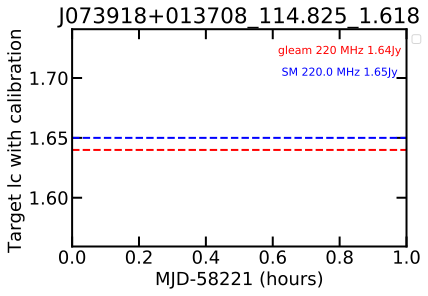

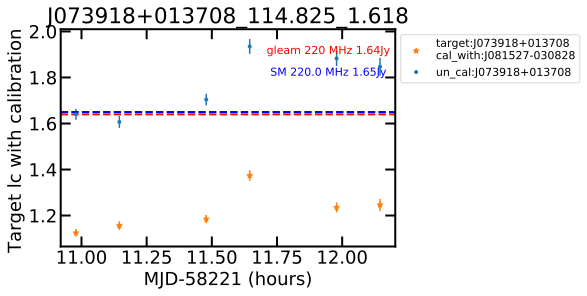

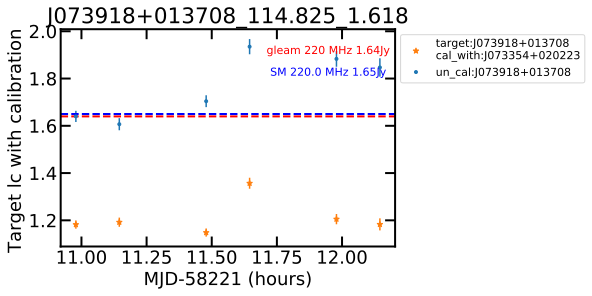

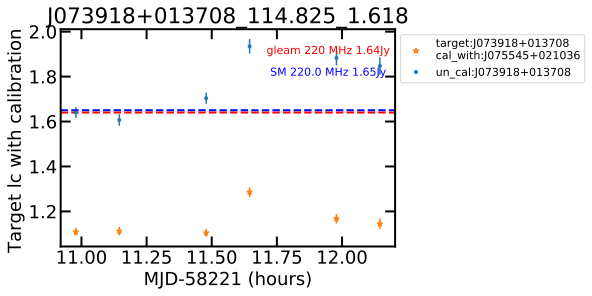

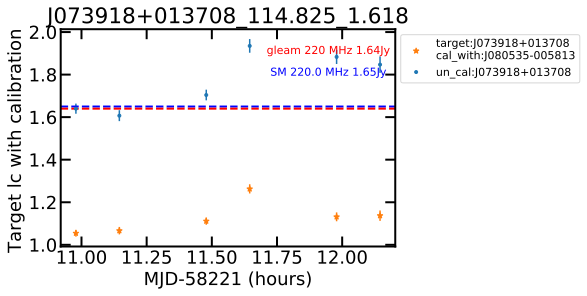

...

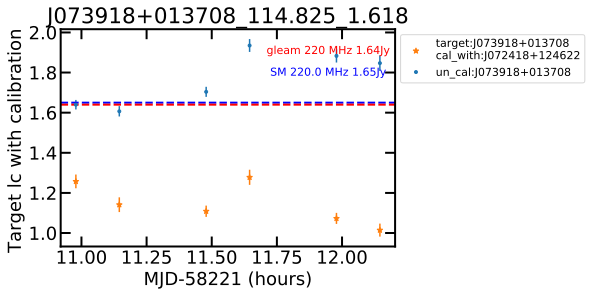

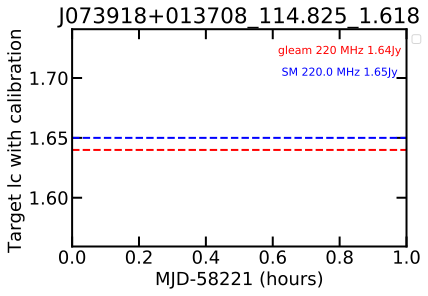

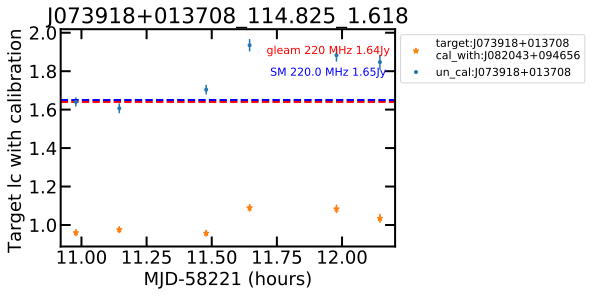

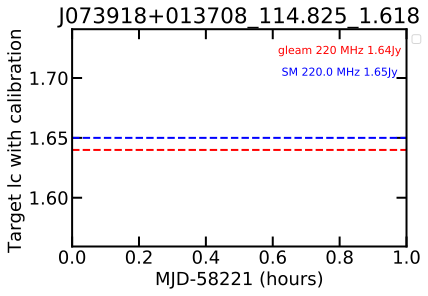

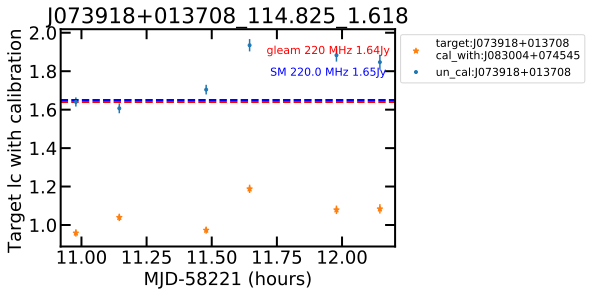

In [257]:
cal_listdata=skymodeldata_100_10Jy
for i in range(0,len(cal_listdata)):
    target_index,cal_index=2,i   
    print(i,'target',skymodeldata_1000_infield_1Jy[target_index]['Name'],'cal',cal_listdata[cal_index]['Name'],)
    plot_calibrate_lightcurve(path_157,target_index,skymodeldata_1000_infield_1Jy,cal_index,cal_listdata,calibration_1000_data_220,intmjd0=58221,prefix='src1000_large1',)

In [235]:
calibration_1000_data_220.columns

ColDefs(
    name = 'Name'; format = '14A'
    name = 'ra'; format = 'D'
    name = 'dec'; format = 'D'
    name = 'ra_str'; format = '10A'
    name = 'dec_str'; format = '9A'
    name = 'a'; format = 'D'
    name = 'b'; format = 'D'
    name = 'pa'; format = 'D'
    name = 'freq'; format = 'D'
    name = 'flux'; format = 'D'
)

# Variability measures

## modulation index

<span style="font-size:larger;">
$$m=\frac{\sigma_s}{\bar{S}}$$
</span>     

%\begin{displaymath}
<span style="font-size:larger;">
$$\bar{S}=\frac{\sum_{i=1}^{n}\, (\frac{S_i}{\sigma_i^2})}{\sum_{i=1}^{n}\,(\frac{1}{\sigma_i^2})}$$
</span>    
%\end{displaymath}

## chi-square of lc

<span style="font-size:larger;">
$$\chi_{lc}^2=\sum_{i=1}^{n} \frac{(S_i-\bar{S})^2}{\sigma_i^2}  $$
</span>  


<span style="font-size:larger;">
$$\chi_{red}^2= \frac{\chi_{lc}^2}{n-1}$$
</span>   


<span style="font-size:larger;">
$$(\frac{\chi_{red}^2}{2.91} -1)(\frac{m}{3 per cent})>1$$
</span>   

In [302]:
df_nan_157_src1000_large3

,obsid,mjd,freq,flux,flux_err,peak_flux,err_peak_flux,dec,ra
0,1207742064,58222.496331,215,1.8353033065795898,0.03467795252799988,1.9527877569198608,0.03282675892114639,1.618,114.825
1,1208086720,58226.485405,215,1.8551079034805298,0.03783578425645828,1.957698941230774,0.035449933260679245,1.618,114.825
2,1208431376,58230.474479,215,1.7989192008972168,0.03553507849574089,1.9092178344726562,0.033575933426618576,1.618,114.825
3,1208515744,58231.450961,215,1.8057610988616943,0.03178991749882698,1.9273430109024048,0.03016129694879055,1.618,114.825
4,1208776032,58234.463553,215,1.9151430130004883,0.04737277701497078,2.0643489360809326,0.04551555961370468,1.618,114.825
5,1208777832,58234.484387,215,2.7596559524536133,0.5263280868530273,2.943171262741089,0.4875451326370239,1.618,114.825
6,1209120696,58238.452720,215,1.898271083831787,0.0346510112285614,1.9622876644134521,0.03188129886984825,1.618,114.825


In [314]:
modulation_df=df_nan_157_src1000_large3[df_nan_157_src1000_large3['flux']<2.5]
modulation_df=modulation_df.reset_index(drop=True)

s_bar=np.sum(modulation_df['flux']/modulation_df['flux_err']**2)/np.sum(1/modulation_df['flux_err']**2)
sigma_s=np.std(modulation_df['flux'])
m=sigma_s/s_bar
print('len',len(modulation_df))
print('modulation index',m)

len 6
modulation index 0.023596377857136093


In [315]:
chisq_lc=np.sum((modulation_df['flux']-s_bar)**2/modulation_df['flux_err']**2)
print('chisq_lc',chisq_lc)

chisq_red=chisq_lc/(len(modulation_df)-1)
print('chisq_red',chisq_red)

chisq_lc 7.910438008412709
chisq_red 1.5820876016825418


In [318]:
(chisq_red/2.91-1)*(m/0.03-1)

<Quantity 0.09740492>

## def_modulation

In [326]:
def return_modulation_chisq(modulation_df):
    
    s_bar=np.sum(modulation_df['flux']/modulation_df['flux_err']**2)/np.sum(1/modulation_df['flux_err']**2)
    sigma_s=np.std(modulation_df['flux'])
    m=sigma_s/s_bar
    #print('len',len(modulation_df))
    #print('modulation index',m)
    chisq_lc=np.sum((modulation_df['flux']-s_bar)**2/modulation_df['flux_err']**2)
    #print('chisq_lc',chisq_lc)

    chisq_red=chisq_lc/(len(modulation_df)-1)
    #print('chisq_red',chisq_red)
    return  m,chisq_lc,chisq_red
    

In [332]:
def def_modulation_sources(path,selectdata,prefix='src1000_large1',gleamlabel=False):
    if gleamlabel==True:
        ralabel='RAJ2000'
        declabel='DEJ2000'
        
    else:
        ralabel='ra'
        declabel='dec'

    ras=selectdata[ralabel]
    decs=selectdata[declabel]
    names=selectdata['Name']

    for index,(ra_,dec_,name_) in enumerate(zip(ras,decs,names)):    
        
        no_table_obsids,no_select_obsids, with_noise_obsids,df_= \
                return_table_of_onesource(path,ra_,dec_,prefix)
        
        if len(df_)>1:
            m,chisq_lc,chisq_red=return_modulation_chisq(df_)
            print(index,name_,m,chisq_lc,chisq_red)
            


In [333]:
def_modulation_sources(path_157,skymodeldata_1000_infield_1Jy,prefix='src1000_large1',gleamlabel=False)

1 J073354+020223 0.05685085898578673 1150.864820767937 230.17296415358743
2 J073918+013708 0.07210403040473823 109.65176061858301 21.930352123716602
3 J073433+031515 0.06586902740663741 34.560909935314655 6.912181987062931
4 J074049+014257 0.07925397540071254 40.65201684092928 8.130403368185856
5 J074244+010602 0.02912336512757171 3.660235893975122 0.7320471787950245
6 J074406+030157 0.11725344407627351 36.41819603382546 7.283639206765092
7 J074200+005211 0.07469939778242334 16.187872700447514 3.237574540089503
8 J073826+020438 0.06715631838955666 12.28521579248336 2.457043158496672
9 J074458+032253 0.06774666146033392 19.9336398539889 3.98672797079778
10 J073757+013705 0.1204295306887407 18.967091213131454 3.7934182426262906
11 J073353+035936 0.1405026271221419 25.814858026805187 5.1629716053610375


In [334]:
def_modulation_sources(path_src1000_large3,skymodeldata_1000_infield_1Jy,prefix='src1000_large3',gleamlabel=False)

1 J073354+020223 0.05914951173820423 1127.625946308991 225.52518926179818
2 J073918+013708 0.061514279458883915 69.06250499468574 13.812500998937148
3 J073433+031515 0.07800829136706718 43.6310553314871 8.72621106629742
4 J074049+014257 0.07950882855809895 37.83172477423782 7.566344954847564
5 J074244+010602 0.04324797819093768 5.855779907665653 1.1711559815331305
6 J074406+030157 0.11537514668615467 35.19401183395724 7.038802366791448
7 J074200+005211 0.09990582172089954 23.333768840631073 4.666753768126215
8 J073826+020438 0.061248173924019794 10.18985556093256 2.0379711121865123
9 J074458+032253 0.06946096264969392 17.25253081880316 3.4505061637606316
10 J073757+013705 0.14132462126901826 24.52019634638373 4.904039269276746
11 J073353+035936 0.20312820413946484 43.96652586394328 8.793305172788656


In [335]:
def_modulation_sources(path_src1000_large3,skymodeldata_100_10Jy,prefix='src1000_large3',gleamlabel=False)

1 J081527-030828 0.033248430247492904 1606.4710526295346 321.2942105259069
2 J073354+020223 0.05914951173820423 1127.625946308991 225.52518926179818
3 J075545+021036 0.04328431907287814 507.85743329590116 101.57148665918024
4 J080535-005813 0.03375621141548845 253.53457320653416 50.70691464130683
6 J080447+101520 0.05316289953824795 1246.012358721975 249.202471744395
7 J081522+015505 0.03379066290782335 507.05055128813376 101.41011025762676
8 J082231+055626 0.02953875147066724 128.25970544746093 32.06492636186523
9 J071302+114614 0.09282986863545571 752.4333208922982 150.48666417845965
10 J081203-054921 0.029035457346304177 121.28116992488395 24.25623398497679
11 J080133+141441 0.05646224609389022 624.0562535373739 124.81125070747478
13 J072810+143736 0.08579519799639754 485.6293176837812 97.12586353675624
14 J072418+124622 0.08094624862187963 81.80524637070917 16.361049274141834
16 J082043+094656 0.03390676458230153 84.73272423395116 16.946544846790232
17 J071404+143621 0.109316756156